# Final Project: The Battle of the Neighborhoods

## Data Acquistion
We need the following data:
<li>NYC Crime data</li>
<li>geojson of NYC</li>
<li>Foursquare NYC data</li>

## Project Description:
A big city in New York can be scary. We created this file to compare NYC neighborhoods by boroughs and neighborhoods. This guide would be perfect for new people who just moved to the city and wants to know which neighborhood fits them in terms of popular venues and low crime rate.

## Data Question:
<p>What are some safe neighborhoods in Manhattan? Which ones aren't</p>
<p>Visualization of the neighborhoods and crime stats?
<p>My project at first was to analyze NYC as well, but I decided to change my focus onto crime prevention instead of finding a spot for a new sushi restaurant (as in the first week's notebook). </p>

# Import libraries

In [2]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

print('Libraries imported.')

Libraries imported.


### Foursquare API credentials 

In [3]:
CLIENT_ID = 'PR5IHUD5WXBUSX1XXQSNAXUEL0GQBXPDICHXCLLOXYCTMWJC' # your Foursquare ID
CLIENT_SECRET = 'IB5FABAMKAVKYYHXBFLLFODFFURIWVMGIIFXDFP4AWDACUF2' # your Foursquare Secret

VERSION = '20200101'
LIMIT = 30

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: PR5IHUD5WXBUSX1XXQSNAXUEL0GQBXPDICHXCLLOXYCTMWJC
CLIENT_SECRET:IB5FABAMKAVKYYHXBFLLFODFFURIWVMGIIFXDFP4AWDACUF2


### Read the crime dataset
<p>The dataset goes back to early 2000s, however that is a lot of data to process. We will just use a fraction of the data, the 2015-2016 crime dataset, which was kindly provided by kaggle: https://www.kaggle.com/adamschroeder/crimes-new-york-city/version/1#NYPD_Complaint_Data_Historic.csv

In [4]:
df = pd.read_csv("NYPD_Complaint_Data_Historic 2.csv")

/Users/baongocdinh/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [5]:
#drop NA 
df = df.dropna(subset=['Latitude','Longitude'], axis=0,how='any')


In [8]:
df

KeyboardInterrupt: 

In [9]:
df.columns

Index(['CMPLNT_NUM', 'CMPLNT_FR_DT', 'CMPLNT_FR_TM', 'CMPLNT_TO_DT',
       'CMPLNT_TO_TM', 'RPT_DT', 'KY_CD', 'OFNS_DESC', 'PD_CD', 'PD_DESC',
       'CRM_ATPT_CPTD_CD', 'LAW_CAT_CD', 'JURIS_DESC', 'BORO_NM',
       'ADDR_PCT_CD', 'LOC_OF_OCCUR_DESC', 'PREM_TYP_DESC', 'PARKS_NM',
       'HADEVELOPT', 'X_COORD_CD', 'Y_COORD_CD', 'Latitude', 'Longitude',
       'Lat_Lon'],
      dtype='object')

<p>Rename the column for better naming convention</p>

In [10]:
df.columns = ['Complaint Number', 'Complaint From Date','Complaint from Time','Complaint To Date','Complaint to Time','Report Date','Offense Classification Code','Offense Description','Internal Classification','internal classification description','Crime successfully completed','Level of offense','Jurisdiction Description','Borough Name','Precinct','Location of Occurence','Premise Description','NYC Park Name','NYCHA Development','X coordinate','Y coordinate','Latitude','Longitude','Lat_Lon']
df.head()

,Complaint Number,Complaint From Date,Complaint from Time,Complaint To Date,Complaint to Time,Report Date,Offense Classification Code,Offense Description,Internal Classification,internal classification description,Crime successfully completed,Level of offense,Jurisdiction Description,Borough Name,Precinct,Location of Occurence,Premise Description,NYC Park Name,NYCHA Development,X coordinate,Y coordinate,Latitude,Longitude,Lat_Lon
0,101109527,12/31/2015,23:45:00,NaN,NaN,12/31/2015,113,FORGERY,729.0,"FORGERY,ETC.,UNCLASSIFIED-FELO",COMPLETED,FELONY,N.Y. POLICE DEPT,BRONX,44.0,INSIDE,BAR/NIGHT CLUB,NaN,NaN,1007314.0,241257.0,40.828848,-73.916661,"(40.828848333, -73.916661142)"
1,153401121,12/31/2015,23:36:00,NaN,NaN,12/31/2015,101,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,COMPLETED,FELONY,N.Y. POLICE DEPT,QUEENS,103.0,OUTSIDE,NaN,NaN,NaN,1043991.0,193406.0,40.697338,-73.784557,"(40.697338138, -73.784556739)"
2,569369778,12/31/2015,23:30:00,NaN,NaN,12/31/2015,117,DANGEROUS DRUGS,503.0,"CONTROLLED SUBSTANCE,INTENT TO",COMPLETED,FELONY,N.Y. POLICE DEPT,MANHATTAN,28.0,NaN,OTHER,NaN,NaN,999463.0,231690.0,40.802607,-73.945052,"(40.802606608, -73.945051911)"
3,968417082,12/31/2015,23:30:00,NaN,NaN,12/31/2015,344,ASSAULT 3 & RELATED OFFENSES,101.0,ASSAULT 3,COMPLETED,MISDEMEANOR,N.Y. POLICE DEPT,QUEENS,105.0,INSIDE,RESIDENCE-HOUSE,NaN,NaN,1060183.0,177862.0,40.654549,-73.726339,"(40.654549444, -73.726338791)"
4,641637920,12/31/2015,23:25:00,12/31/2015,23:30:00,12/31/2015,344,ASSAULT 3 & RELATED OFFENSES,101.0,ASSAULT 3,COMPLETED,MISDEMEANOR,N.Y. POLICE DEPT,MANHATTAN,13.0,FRONT OF,OTHER,NaN,NaN,987606.0,208148.0,40.738002,-73.987891,"(40.7380024, -73.98789129)"


In [11]:
df['Offense Description']=df['Offense Description'].astype(str)

<p>Remove Columns we don't need

In [12]:
df.drop(['Complaint Number','Complaint from Time','Complaint To Date','Complaint to Time','Internal Classification','NYC Park Name','NYCHA Development'],axis=1,inplace=True)

In [13]:
df.drop(['internal classification description'],axis=1,inplace=True)

In [14]:
df.shape

(1016158, 16)

In [15]:
df.head()

,Complaint From Date,Report Date,Offense Classification Code,Offense Description,Crime successfully completed,Level of offense,Jurisdiction Description,Borough Name,Precinct,Location of Occurence,Premise Description,X coordinate,Y coordinate,Latitude,Longitude,Lat_Lon
0,12/31/2015,12/31/2015,113,FORGERY,COMPLETED,FELONY,N.Y. POLICE DEPT,BRONX,44.0,INSIDE,BAR/NIGHT CLUB,1007314.0,241257.0,40.828848,-73.916661,"(40.828848333, -73.916661142)"
1,12/31/2015,12/31/2015,101,MURDER & NON-NEGL. MANSLAUGHTER,COMPLETED,FELONY,N.Y. POLICE DEPT,QUEENS,103.0,OUTSIDE,NaN,1043991.0,193406.0,40.697338,-73.784557,"(40.697338138, -73.784556739)"
2,12/31/2015,12/31/2015,117,DANGEROUS DRUGS,COMPLETED,FELONY,N.Y. POLICE DEPT,MANHATTAN,28.0,NaN,OTHER,999463.0,231690.0,40.802607,-73.945052,"(40.802606608, -73.945051911)"
3,12/31/2015,12/31/2015,344,ASSAULT 3 & RELATED OFFENSES,COMPLETED,MISDEMEANOR,N.Y. POLICE DEPT,QUEENS,105.0,INSIDE,RESIDENCE-HOUSE,1060183.0,177862.0,40.654549,-73.726339,"(40.654549444, -73.726338791)"
4,12/31/2015,12/31/2015,344,ASSAULT 3 & RELATED OFFENSES,COMPLETED,MISDEMEANOR,N.Y. POLICE DEPT,MANHATTAN,13.0,FRONT OF,OTHER,987606.0,208148.0,40.738002,-73.987891,"(40.7380024, -73.98789129)"


In [16]:
#reverse geocoding
import geopandas as gpd
import geopy
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
import reverse_geocoder as rg
locator = Nominatim(user_agent="foursquare_agent",timeout=10)
rgeocode = RateLimiter(locator.reverse, min_delay_seconds=0.001)
coords = tuple(zip(df['Latitude'], df['Longitude']))
results_rg = rg.search(coords)
results_name = [x.get('name') for x in results_rg]

# Optional: insert admin2 results into new df column
df['name'] = results_name


Loading formatted geocoded file...


In [17]:
df.drop(['Lat_Lon'],axis=1,inplace=True)

In [18]:
df.shape

(1016158, 16)

In [19]:
df['name'].value_counts()

Brooklyn               122755
The Bronx              111534
Inwood                 111322
Manhattan               96656
New York City           88844
Long Island City        88695
East New York           85648
Jamaica                 55291
Bensonhurst             46810
Borough of Queens       41246
Edgewater               26849
Weehawken               20886
Eastchester             18227
Bayonne                 17947
Coney Island            14949
Staten Island           13737
Bellerose Terrace       10995
Bloomfield              10361
East Atlantic Beach      7665
South Valley Stream      5738
Mount Vernon             2733
Fort Lee                 2556
Carteret                 2389
Hoboken                  1868
Elmont                   1726
Perth Amboy              1380
Atlantic Beach           1360
Yonkers                  1200
Guttenberg               1179
Lake Success              889
Bellerose                 789
Sewaren                   448
North New Hyde Park       446
Pelham Man

In [20]:
# View the information of the dataset 
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1016158 entries, 0 to 1048574
Data columns (total 16 columns):
Complaint From Date             1016095 non-null object
Report Date                     1016158 non-null object
Offense Classification Code     1016158 non-null int64
Offense Description             1016158 non-null object
Crime successfully completed    1016157 non-null object
Level of offense                1016158 non-null object
Jurisdiction Description        1016158 non-null object
Borough Name                    1016158 non-null object
Precinct                        1016158 non-null float64
Location of Occurence           812846 non-null object
Premise Description             1011657 non-null object
X coordinate                    1016158 non-null float64
Y coordinate                    1016158 non-null float64
Latitude                        1016158 non-null float64
Longitude                       1016158 non-null float64
name                            1016158 non-

In [21]:
df['Offense Description'].value_counts()


PETIT LARCENY                           176505
HARRASSMENT 2                           131925
ASSAULT 3 & RELATED OFFENSES            113211
CRIMINAL MISCHIEF & RELATED OF          100762
GRAND LARCENY                            94376
DANGEROUS DRUGS                          56042
OFF. AGNST PUB ORD SENSBLTY &            44447
FELONY ASSAULT                           43482
ROBBERY                                  36146
BURGLARY                                 34714
MISCELLANEOUS PENAL LAW                  28797
DANGEROUS WEAPONS                        22294
OFFENSES AGAINST PUBLIC ADMINI           21086
GRAND LARCENY OF MOTOR VEHICLE           15937
INTOXICATED & IMPAIRED DRIVING           14331
VEHICLE AND TRAFFIC LAWS                 11600
FORGERY                                  10409
THEFT-FRAUD                              10395
CRIMINAL TRESPASS                        10185
FRAUDS                                    7757
POSSESSION OF STOLEN PROPERTY             4842
UNAUTHORIZED 

In [22]:
df['Premise Description'].value_counts()

STREET                          312295
RESIDENCE - APT. HOUSE          222632
RESIDENCE-HOUSE                  95164
RESIDENCE - PUBLIC HOUSING       77851
OTHER                            27863
COMMERCIAL BUILDING              26719
CHAIN STORE                      23968
DEPARTMENT STORE                 22947
TRANSIT - NYC SUBWAY             21871
GROCERY/BODEGA                   15217
RESTAURANT/DINER                 13221
BAR/NIGHT CLUB                   12241
PARK/PLAYGROUND                  12022
PUBLIC SCHOOL                    10438
CLOTHING/BOUTIQUE                 9644
DRUG STORE                        9267
FOOD SUPERMARKET                  6356
PUBLIC BUILDING                   6321
FAST FOOD                         5876
PARKING LOT/GARAGE (PRIVATE)      5018
PARKING LOT/GARAGE (PUBLIC)       4995
HOSPITAL                          4890
HOTEL/MOTEL                       4519
SMALL MERCHANT                    4272
STORE UNCLASSIFIED                4260
BANK                     

In [23]:
df['Borough Name'].value_counts()

BROOKLYN         308786
MANHATTAN        237833
BRONX            220109
QUEENS           202029
STATEN ISLAND     47401
Name: Borough Name, dtype: int64

In [24]:
df['No_of_Crimes']=1

No_of_Crimes                              \
Premise Description ABANDONED BUILDING AIRPORT TERMINAL  ATM  BANK   
Borough Name                                                         
BRONX                               57                1  112   621   
BROOKLYN                           155                5  292   899   
MANHATTAN                          146                3  314  1688   
QUEENS                             171             1434  160   815   
STATEN ISLAND                       55                4   36   152   

                                                                         \
Premise Description BAR/NIGHT CLUB BEAUTY & NAIL SALON BOOK/CARD BRIDGE   
Borough Name                                                              
BRONX                          819                 569        13    105   
BROOKLYN                      2198                 895        60    128   
MANHATTAN                     6652                 776       195    325   
QUEENS                        2328                 611        31    293   
STATEN ISLAND                  244                 113        16     96   

                                                                         \
Premise Description BUS (NYC TRANSIT) BUS (OTHER) BUS STOP BUS TERMINAL   
Borough Name                                                              
BRONX                             588          87      185           10   
BROOKLYN                          721         130      196            9   
MANHATTAN                         372         145      110          679   
QUEENS                            421          85      201           20   
STATEN ISLAND                     240          50       94           14   

                                                                             \
Premise Description CANDY STORE CEMETERY CHAIN STORE CHECK CASHING BUSINESS   
Borough Name                                                                  
BRONX                       292        8        3493                    421   
BROOKLYN                    421       14        5778                    495   
MANHATTAN                   369        8        9745                    224   
QUEENS                      190       24        3901                    209   
STATEN ISLAND                32       18        1051                     47   

                                                                  \
Premise Description CHURCH CLOTHING/BOUTIQUE COMMERCIAL BUILDING   
Borough Name                                                       
BRONX                  302               716                3187   
BROOKLYN               510              1391                6685   
MANHATTAN              491              6514               10268   
QUEENS                 381               857                5302   
STATEN ISLAND          108               166                1277   

                                                                              \
Premise Description CONSTRUCTION SITE DEPARTMENT STORE DOCTOR/DENTIST OFFICE   
Borough Name                                                                   
BRONX                             207             3788                   454   
BROOKLYN                          586             4737                   754   
MANHATTAN                         560             8480                   676   
QUEENS                            249             4673                   518   
STATEN ISLAND                      75             1269                   138   

                                                                      \
Premise Description DRUG STORE DRY CLEANER/LAUNDRY FACTORY/WAREHOUSE   
Borough Name                                                           
BRONX                     1448                 529               204   
BROOKLYN                  1986                 889               455   
MANHATTAN                 3517                 367                59   
QUEENS      

In [ ]:
Newyork_crime = pd.pivot_table(df,values=['No_of_Crimes'],
                               index=['Borough Name'],
                               columns=['Offense Description'],
                               aggfunc=np.sum,fill_value=0)
Newyork_crime.head()

In [26]:
# Reset the index
Newyork_crime.reset_index(inplace = True)

In [32]:
# Total crimes per Borough
Newyork_crime['Total'] = Newyork_crime.sum(axis=1)
Newyork_crime.head()

Borough Name No_of_Crimes                      \
Offense Description                    ABORTION ADMINISTRATIVE CODE   
0                            BRONX            0                 456   
1                         BROOKLYN            0                 893   
2                        MANHATTAN            0                 249   
3                           QUEENS            2                 618   
4                    STATEN ISLAND            0                  90   

                                                                               \
Offense Description ADMINISTRATIVE CODES AGRICULTURE & MRKTS LAW-UNCLASSIFIED   
0                                      0                                   29   
1                                      1                                   19   
2                                      0                                   16   
3                                      1                                   13   
4                                      0                                    6   

                                                                          \
Offense Description ALCOHOLIC BEVERAGE CONTROL LAW ANTICIPATORY OFFENSES   
0                                               80                     2   
1                                               27                     3   
2                                               34                     3   
3                                               19                     1   
4                                                1                     0   

                                                                        \
Offense Description ARSON ASSAULT 3 & RELATED OFFENSES BURGLAR'S TOOLS   
0                     751                        28641              76   
1                     765                        35410             173   
2                     452                        21284             290   
3                     347                        23089             149   
4                     124                         4787              18   

                                                            \
Offense Description BURGLARY CHILD ABANDONMENT/NON SUPPORT   
0                       6025                            20   
1                      12718                            15   
2                       6072                             9   
3                       8602                            16   
4                       1297                             0   

                                                                      \
Offense Description CRIMINAL MISCHIEF & RELATED OF CRIMINAL TRESPASS   
0                                            21238              2213   
1                                            31349              2219   
2                                            19580              3664   
3                                            22579              1828   
4                                             6016               261   

                                                                          \
Offense Description DANGEROUS DRUGS DANGEROUS WEAPONS DISORDERLY CONDUCT   
0                             21028              6856                 36   
1                             15930              6250                 50   
2                             13377              4241                 23   
3                              4082              4204                 10   
4                              1625               743                  0   

                                                                         \
Offense Description DISRUPTION OF A RELIGIOUS SERV ENDAN WELFARE INCOMP   
0                                                2                   11   
1                                                6                   16   
2                                                3                   10   
3                                                2      

In [33]:
Newyork_crime_2 = pd.pivot_table(df,values=['No_of_Crimes'],
                               index=['name'],
                               columns=['Offense Description'],
                               aggfunc=np.sum,fill_value=0)
Newyork_crime_2.head()

No_of_Crimes                                           \
Offense Description     ABORTION ADMINISTRATIVE CODE ADMINISTRATIVE CODES   
name                                                                        
Atlantic Beach                 0                   3                    0   
Bayonne                        0                  53                    0   
Bellerose                      0                   1                    0   
Bellerose Terrace              0                  65                    0   
Bensonhurst                    0                  91                    0   

                                                          \
Offense Description AGRICULTURE & MRKTS LAW-UNCLASSIFIED   
name                                                       
Atlantic Beach                                         0   
Bayonne                                                1   
Bellerose                                              0   
Bellerose Terrace                                      0   
Bensonhurst                                            6   

                                                                          \
Offense Description ALCOHOLIC BEVERAGE CONTROL LAW ANTICIPATORY OFFENSES   
name                                                                       
Atlantic Beach                                   0                     0   
Bayonne                                          0                     0   
Bellerose                                        0                     0   
Bellerose Terrace                                0                     0   
Bensonhurst                                      2                     0   

                                                                        \
Offense Description ARSON ASSAULT 3 & RELATED OFFENSES BURGLAR'S TOOLS   
name                                                                     
Atlantic Beach          1                          152               0   
Bayonne                65                         2318               8   
Bellerose               0                           62               0   
Bellerose Terrace      23                         1249               2   
Bensonhurst            80                         4736              31   

                                                            \
Offense Description BURGLARY CHILD ABANDONMENT/NON SUPPORT   
name                                                         
Atlantic Beach            61                             1   
Bayonne                  477                             0   
Bellerose                 52                             0   
Bellerose Terrace        545                             1   
Bensonhurst             2241                             1   

                                                                      \
Offense Description CRIMINAL MISCHIEF & RELATED OF CRIMINAL TRESPASS   
name                                                                   
Atlantic Beach                                 127                13   
Bayonne                                       2214               126   
Bellerose                                       93                 1   
Bellerose Terrace                             1348                75   
Bensonhurst                                   5247               375   

                                                                          \
Offense Description DANGEROUS DRUGS DANGEROUS WEAPONS DISORDERLY CONDUCT   
name                                                                       
Atlantic Beach                   16                39                  0   
Bayonne                         656               319                  0   
Bellerose                        15                 6                  0   
Bellerose Terrace               105               216                  2   
Bensonhurst                    2153               684                  4   

                                     

Note: Reverse geocoding is expensive, and our geocoding software is not perfect. The geocoding package here used cannot get us the specific neighborhood (UWS, LES, CHINATOWN....). Thus, we cannot merge this dataset with our geojson data, which is more specific.

In [34]:
# Reset the index
Newyork_crime_2.reset_index(inplace = True)

In [35]:
# Total crimes per Borough
Newyork_crime_2['Total'] = Newyork_crime_2.sum(axis=1)
Newyork_crime_2.head()

name No_of_Crimes                      \
Offense Description                        ABORTION ADMINISTRATIVE CODE   
0                       Atlantic Beach            0                   3   
1                              Bayonne            0                  53   
2                            Bellerose            0                   1   
3                    Bellerose Terrace            0                  65   
4                          Bensonhurst            0                  91   

                                                                               \
Offense Description ADMINISTRATIVE CODES AGRICULTURE & MRKTS LAW-UNCLASSIFIED   
0                                      0                                    0   
1                                      0                                    1   
2                                      0                                    0   
3                                      0                                    0   
4                                      0                                    6   

                                                                          \
Offense Description ALCOHOLIC BEVERAGE CONTROL LAW ANTICIPATORY OFFENSES   
0                                                0                     0   
1                                                0                     0   
2                                                0                     0   
3                                                0                     0   
4                                                2                     0   

                                                                        \
Offense Description ARSON ASSAULT 3 & RELATED OFFENSES BURGLAR'S TOOLS   
0                       1                          152               0   
1                      65                         2318               8   
2                       0                           62               0   
3                      23                         1249               2   
4                      80                         4736              31   

                                                            \
Offense Description BURGLARY CHILD ABANDONMENT/NON SUPPORT   
0                         61                             1   
1                        477                             0   
2                         52                             0   
3                        545                             1   
4                       2241                             1   

                                                                      \
Offense Description CRIMINAL MISCHIEF & RELATED OF CRIMINAL TRESPASS   
0                                              127                13   
1                                             2214               126   
2                                               93                 1   
3                                             1348                75   
4                                             5247               375   

                                                                          \
Offense Description DANGEROUS DRUGS DANGEROUS WEAPONS DISORDERLY CONDUCT   
0                                16                39                  0   
1                               656               319                  0   
2                                15                 6                  0   
3                               105               216                  2   
4                              2153               684                  4   

                                                                         \
Offense Description DISRUPTION OF A RELIGIOUS SERV ENDAN WELFARE INCOMP   
0                                                0                    0   
1                                                0                    0   
2                                                0                    0   
3                                       

In [36]:
Newyork_crime.columns = Newyork_crime.columns.map(''.join)
Newyork_crime.head()

,Borough Name,No_of_CrimesABORTION,No_of_CrimesADMINISTRATIVE CODE,No_of_CrimesADMINISTRATIVE CODES,No_of_CrimesAGRICULTURE & MRKTS LAW-UNCLASSIFIED,No_of_CrimesALCOHOLIC BEVERAGE CONTROL LAW,No_of_CrimesANTICIPATORY OFFENSES,No_of_CrimesARSON,No_of_CrimesASSAULT 3 & RELATED OFFENSES,No_of_CrimesBURGLAR'S TOOLS,No_of_CrimesBURGLARY,No_of_CrimesCHILD ABANDONMENT/NON SUPPORT,No_of_CrimesCRIMINAL MISCHIEF & RELATED OF,No_of_CrimesCRIMINAL TRESPASS,No_of_CrimesDANGEROUS DRUGS,No_of_CrimesDANGEROUS WEAPONS,No_of_CrimesDISORDERLY CONDUCT,No_of_CrimesDISRUPTION OF A RELIGIOUS SERV,No_of_CrimesENDAN WELFARE INCOMP,No_of_CrimesESCAPE 3,No_of_CrimesFELONY ASSAULT,No_of_CrimesFORGERY,No_of_CrimesFORTUNE TELLING,No_of_CrimesFRAUDS,No_of_CrimesFRAUDULENT ACCOSTING,No_of_CrimesGAMBLING,No_of_CrimesGRAND LARCENY,No_of_CrimesGRAND LARCENY OF MOTOR VEHICLE,No_of_CrimesHARRASSMENT 2,"No_of_CrimesHOMICIDE-NEGLIGENT,UNCLASSIFIE",No_of_CrimesHOMICIDE-NEGLIGENT-VEHICLE,No_of_CrimesINTOXICATED & IMPAIRED DRIVING,No_of_CrimesINTOXICATED/IMPAIRED DRIVING,No_of_CrimesJOSTLING,No_of_CrimesKIDNAPPING,No_of_CrimesKIDNAPPING & RELATED OFFENSES,No_of_CrimesKIDNAPPING AND RELATED OFFENSES,No_of_CrimesLOITERING,No_of_CrimesLOITERING FOR DRUG PURPOSES,"No_of_CrimesLOITERING/GAMBLING (CARDS, DIC",No_of_CrimesMISCELLANEOUS PENAL LAW,No_of_CrimesMURDER & NON-NEGL. MANSLAUGHTER,No_of_CrimesNEW YORK CITY HEALTH CODE,No_of_CrimesNYS LAWS-UNCLASSIFIED FELONY,No_of_CrimesNYS LAWS-UNCLASSIFIED VIOLATION,No_of_CrimesOFF. AGNST PUB ORD SENSBLTY &,No_of_CrimesOFFENSES AGAINST PUBLIC ADMINI,No_of_CrimesOFFENSES AGAINST PUBLIC SAFETY,No_of_CrimesOFFENSES AGAINST THE PERSON,No_of_CrimesOFFENSES INVOLVING FRAUD,No_of_CrimesOFFENSES RELATED TO CHILDREN,No_of_CrimesOTHER OFFENSES RELATED TO THEF,No_of_CrimesOTHER STATE LAWS,No_of_CrimesOTHER STATE LAWS (NON PENAL LA,No_of_CrimesOTHER STATE LAWS (NON PENAL LAW),No_of_CrimesOTHER TRAFFIC INFRACTION,No_of_CrimesPETIT LARCENY,No_of_CrimesPETIT LARCENY OF MOTOR VEHICLE,No_of_CrimesPOSSESSION OF STOLEN PROPERTY,No_of_CrimesPROSTITUTION & RELATED OFFENSES,No_of_CrimesROBBERY,No_of_CrimesSEX CRIMES,No_of_CrimesTHEFT OF SERVICES,No_of_CrimesTHEFT-FRAUD,No_of_CrimesUNAUTHORIZED USE OF A VEHICLE,No_of_CrimesUNDER THE INFLUENCE OF DRUGS,No_of_CrimesUNLAWFUL POSS. WEAP. ON SCHOOL,No_of_CrimesVEHICLE AND TRAFFIC LAWS,No_of_Crimesnan,Total
0,BRONX,0,456,0,29,80,2,751,28641,76,6025,20,21238,2213,21028,6856,36,2,11,5,12092,2128,0,1456,39,218,13105,3224,27703,3,0,2261,3,4,0,79,0,0,0,1,4330,198,1,222,2,9808,6638,49,758,652,130,602,4,303,0,1,31231,14,796,132,8919,17,180,1765,495,0,0,2492,585,220109
1,BROOKLYN,0,893,1,19,27,3,765,35410,173,12718,15,31349,2219,15930,6250,50,6,16,8,14051,3179,0,2201,19,110,26279,5488,41718,4,2,4598,4,14,1,133,0,1,1,8,11430,285,8,346,1,13606,4541,37,676,465,58,915,9,169,1,2,49817,74,1619,36,12694,1,69,2939,1200,0,1,3507,617,308786
2,MANHATTAN,0,249,0,16,34,3,452,21284,290,6072,9,19580,3664,13377,4241,23,3,10,6,7395,2745,1,1980,350,204,34737,1633,26009,0,2,2536,1,50,0,45,2,1,0,10,4309,86,15,208,2,8414,5230,52,660,1461,8,765,11,451,0,0,53902,21,1433,35,6477,4,678,3105,368,0,6,2183,935,237833
3,QUEENS,2,618,1,13,19,1,347,23089,149,8602,16,22579,1828,4082,4204,10,2,14,4,8495,2218,0,1499,30,12,17509,5127,27257,0,1,3629,7,11,1,61,0,0,0,0,7513,134,1,95,1,9462,3250,19,495,312,105,647,7,69,0,0,33766,38,819,16,7088,0,58,1959,1095,1,1,3075,566,202029
4,STATEN ISLAND,0,90,0,6,1,0,124,4787,18,1297,0,6016,261,1625,743,0,0,1,1,1449,139,0,621,0,0,2746,465,9238,0,1,1307,0,0,0,8,0,0,0,0,1215,30,0,68,0,3157,1427,13,115,41,1,90,0,29,0,0,7789,7,175,0,968,0,0,627,273,1,0,343,88,47401


In [37]:
Newyork_crime_2.columns = Newyork_crime_2.columns.map(''.join)
Newyork_crime_2.head()

,name,No_of_CrimesABORTION,No_of_CrimesADMINISTRATIVE CODE,No_of_CrimesADMINISTRATIVE CODES,No_of_CrimesAGRICULTURE & MRKTS LAW-UNCLASSIFIED,No_of_CrimesALCOHOLIC BEVERAGE CONTROL LAW,No_of_CrimesANTICIPATORY OFFENSES,No_of_CrimesARSON,No_of_CrimesASSAULT 3 & RELATED OFFENSES,No_of_CrimesBURGLAR'S TOOLS,No_of_CrimesBURGLARY,No_of_CrimesCHILD ABANDONMENT/NON SUPPORT,No_of_CrimesCRIMINAL MISCHIEF & RELATED OF,No_of_CrimesCRIMINAL TRESPASS,No_of_CrimesDANGEROUS DRUGS,No_of_CrimesDANGEROUS WEAPONS,No_of_CrimesDISORDERLY CONDUCT,No_of_CrimesDISRUPTION OF A RELIGIOUS SERV,No_of_CrimesENDAN WELFARE INCOMP,No_of_CrimesESCAPE 3,No_of_CrimesFELONY ASSAULT,No_of_CrimesFORGERY,No_of_CrimesFORTUNE TELLING,No_of_CrimesFRAUDS,No_of_CrimesFRAUDULENT ACCOSTING,No_of_CrimesGAMBLING,No_of_CrimesGRAND LARCENY,No_of_CrimesGRAND LARCENY OF MOTOR VEHICLE,No_of_CrimesHARRASSMENT 2,"No_of_CrimesHOMICIDE-NEGLIGENT,UNCLASSIFIE",No_of_CrimesHOMICIDE-NEGLIGENT-VEHICLE,No_of_CrimesINTOXICATED & IMPAIRED DRIVING,No_of_CrimesINTOXICATED/IMPAIRED DRIVING,No_of_CrimesJOSTLING,No_of_CrimesKIDNAPPING,No_of_CrimesKIDNAPPING & RELATED OFFENSES,No_of_CrimesKIDNAPPING AND RELATED OFFENSES,No_of_CrimesLOITERING,No_of_CrimesLOITERING FOR DRUG PURPOSES,"No_of_CrimesLOITERING/GAMBLING (CARDS, DIC",No_of_CrimesMISCELLANEOUS PENAL LAW,No_of_CrimesMURDER & NON-NEGL. MANSLAUGHTER,No_of_CrimesNEW YORK CITY HEALTH CODE,No_of_CrimesNYS LAWS-UNCLASSIFIED FELONY,No_of_CrimesNYS LAWS-UNCLASSIFIED VIOLATION,No_of_CrimesOFF. AGNST PUB ORD SENSBLTY &,No_of_CrimesOFFENSES AGAINST PUBLIC ADMINI,No_of_CrimesOFFENSES AGAINST PUBLIC SAFETY,No_of_CrimesOFFENSES AGAINST THE PERSON,No_of_CrimesOFFENSES INVOLVING FRAUD,No_of_CrimesOFFENSES RELATED TO CHILDREN,No_of_CrimesOTHER OFFENSES RELATED TO THEF,No_of_CrimesOTHER STATE LAWS,No_of_CrimesOTHER STATE LAWS (NON PENAL LA,No_of_CrimesOTHER STATE LAWS (NON PENAL LAW),No_of_CrimesOTHER TRAFFIC INFRACTION,No_of_CrimesPETIT LARCENY,No_of_CrimesPETIT LARCENY OF MOTOR VEHICLE,No_of_CrimesPOSSESSION OF STOLEN PROPERTY,No_of_CrimesPROSTITUTION & RELATED OFFENSES,No_of_CrimesROBBERY,No_of_CrimesSEX CRIMES,No_of_CrimesTHEFT OF SERVICES,No_of_CrimesTHEFT-FRAUD,No_of_CrimesUNAUTHORIZED USE OF A VEHICLE,No_of_CrimesUNDER THE INFLUENCE OF DRUGS,No_of_CrimesUNLAWFUL POSS. WEAP. ON SCHOOL,No_of_CrimesVEHICLE AND TRAFFIC LAWS,No_of_Crimesnan,Total
0,Atlantic Beach,0,3,0,0,0,0,1,152,0,61,1,127,13,16,39,0,0,0,0,78,6,0,8,0,0,72,13,224,0,0,11,0,0,0,0,0,0,0,0,97,0,0,1,0,84,12,0,1,0,0,2,0,1,0,0,264,0,6,0,35,0,0,10,13,0,0,7,2,1360
1,Bayonne,0,53,0,1,0,0,65,2318,8,477,0,2214,126,656,319,0,0,0,1,693,39,0,189,0,0,842,184,3721,0,0,350,0,0,0,4,0,0,0,0,425,20,0,25,0,1009,812,3,48,14,0,32,0,17,0,0,2271,3,53,0,557,0,0,125,118,0,0,128,27,17947
2,Bellerose,0,1,0,0,0,0,0,62,0,52,0,93,1,15,6,0,0,0,0,30,7,0,6,0,0,112,29,107,0,0,14,0,0,0,0,0,0,0,0,30,0,0,1,0,52,14,0,0,0,0,0,0,0,0,0,101,0,4,0,18,0,0,26,0,0,0,5,3,789
3,Bellerose Terrace,0,65,0,0,0,0,23,1249,2,545,1,1348,75,105,216,2,0,1,0,522,181,0,89,0,0,928,266,1756,0,0,127,0,0,0,6,0,0,0,0,452,5,0,2,0,788,171,0,21,13,0,18,0,4,0,0,1211,2,48,0,381,0,0,144,61,0,1,138,28,10995
4,Bensonhurst,0,91,0,6,2,0,80,4736,31,2241,1,5247,375,2153,684,4,3,2,0,1646,268,0,395,3,7,4348,936,6261,1,1,1204,2,2,0,12,0,0,0,0,1420,13,0,34,1,2489,548,4,72,57,2,104,0,13,0,0,8027,3,275,11,1503,0,1,554,245,0,0,605,87,46810


In [38]:
Newyork_crime.describe()

,No_of_CrimesABORTION,No_of_CrimesADMINISTRATIVE CODE,No_of_CrimesADMINISTRATIVE CODES,No_of_CrimesAGRICULTURE & MRKTS LAW-UNCLASSIFIED,No_of_CrimesALCOHOLIC BEVERAGE CONTROL LAW,No_of_CrimesANTICIPATORY OFFENSES,No_of_CrimesARSON,No_of_CrimesASSAULT 3 & RELATED OFFENSES,No_of_CrimesBURGLAR'S TOOLS,No_of_CrimesBURGLARY,No_of_CrimesCHILD ABANDONMENT/NON SUPPORT,No_of_CrimesCRIMINAL MISCHIEF & RELATED OF,No_of_CrimesCRIMINAL TRESPASS,No_of_CrimesDANGEROUS DRUGS,No_of_CrimesDANGEROUS WEAPONS,No_of_CrimesDISORDERLY CONDUCT,No_of_CrimesDISRUPTION OF A RELIGIOUS SERV,No_of_CrimesENDAN WELFARE INCOMP,No_of_CrimesESCAPE 3,No_of_CrimesFELONY ASSAULT,No_of_CrimesFORGERY,No_of_CrimesFORTUNE TELLING,No_of_CrimesFRAUDS,No_of_CrimesFRAUDULENT ACCOSTING,No_of_CrimesGAMBLING,No_of_CrimesGRAND LARCENY,No_of_CrimesGRAND LARCENY OF MOTOR VEHICLE,No_of_CrimesHARRASSMENT 2,"No_of_CrimesHOMICIDE-NEGLIGENT,UNCLASSIFIE",No_of_CrimesHOMICIDE-NEGLIGENT-VEHICLE,No_of_CrimesINTOXICATED & IMPAIRED DRIVING,No_of_CrimesINTOXICATED/IMPAIRED DRIVING,No_of_CrimesJOSTLING,No_of_CrimesKIDNAPPING,No_of_CrimesKIDNAPPING & RELATED OFFENSES,No_of_CrimesKIDNAPPING AND RELATED OFFENSES,No_of_CrimesLOITERING,No_of_CrimesLOITERING FOR DRUG PURPOSES,"No_of_CrimesLOITERING/GAMBLING (CARDS, DIC",No_of_CrimesMISCELLANEOUS PENAL LAW,No_of_CrimesMURDER & NON-NEGL. MANSLAUGHTER,No_of_CrimesNEW YORK CITY HEALTH CODE,No_of_CrimesNYS LAWS-UNCLASSIFIED FELONY,No_of_CrimesNYS LAWS-UNCLASSIFIED VIOLATION,No_of_CrimesOFF. AGNST PUB ORD SENSBLTY &,No_of_CrimesOFFENSES AGAINST PUBLIC ADMINI,No_of_CrimesOFFENSES AGAINST PUBLIC SAFETY,No_of_CrimesOFFENSES AGAINST THE PERSON,No_of_CrimesOFFENSES INVOLVING FRAUD,No_of_CrimesOFFENSES RELATED TO CHILDREN,No_of_CrimesOTHER OFFENSES RELATED TO THEF,No_of_CrimesOTHER STATE LAWS,No_of_CrimesOTHER STATE LAWS (NON PENAL LA,No_of_CrimesOTHER STATE LAWS (NON PENAL LAW),No_of_CrimesOTHER TRAFFIC INFRACTION,No_of_CrimesPETIT LARCENY,No_of_CrimesPETIT LARCENY OF MOTOR VEHICLE,No_of_CrimesPOSSESSION OF STOLEN PROPERTY,No_of_CrimesPROSTITUTION & RELATED OFFENSES,No_of_CrimesROBBERY,No_of_CrimesSEX CRIMES,No_of_CrimesTHEFT OF SERVICES,No_of_CrimesTHEFT-FRAUD,No_of_CrimesUNAUTHORIZED USE OF A VEHICLE,No_of_CrimesUNDER THE INFLUENCE OF DRUGS,No_of_CrimesUNLAWFUL POSS. WEAP. ON SCHOOL,No_of_CrimesVEHICLE AND TRAFFIC LAWS,No_of_Crimesnan,Total
count,5.000000,5.000000,5.000000,5.000000,5.00000,5.00000,5.000000,5.00000,5.000000,5.000000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.00000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.00000,5.00000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.00000,5.00000,5.000000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.000000
mean,0.400000,461.200000,0.400000,16.600000,32.20000,1.80000,487.800000,22642.20000,141.200000,6942.800000,12.000000,20152.400000,2037.000000,11208.40000,4458.800000,23.800000,2.60000,10.400000,4.800000,8696.400000,2081.800000,0.200000,1551.400000,87.600000,108.800000,18875.200000,3187.400000,26385.000000,1.400000,1.20000,2866.20000,3.000000,15.800000,0.400000,65.200000,0.400000,0.400000,0.200000,3.800000,5759.400000,146.600000,5.000000,187.800000,1.20000,8889.400000,4217.200000,34.000000,540.80000,586.200000,60.400000,603.80000,6.20000,204.200000,0.200000,0.600000,35301.000000,30.80000,968.400000,43.800000,7229.200000,4.400000,197.000000,2079.000000,686.200000,0.400000,1.60000,2320.000000,558.200000,203231.600000
std,0.894427,313.800414,0.547723,8.443933,29.42278,1.30384,273.665307,11400.16253,103.250666,4170.778908,7.778175,9118.610272,1215.430582,8155.48909,2391.364401,19.954949,2.19089,5.770615,2.588436,4859.548621,1166.065907,0.447214,608.927171,147.405224,102.709299,12265.049498,2172.772952,11529.954271,1.949359

In [39]:
Newyork_crime_2.describe()

,No_of_CrimesABORTION,No_of_CrimesADMINISTRATIVE CODE,No_of_CrimesADMINISTRATIVE CODES,No_of_CrimesAGRICULTURE & MRKTS LAW-UNCLASSIFIED,No_of_CrimesALCOHOLIC BEVERAGE CONTROL LAW,No_of_CrimesANTICIPATORY OFFENSES,No_of_CrimesARSON,No_of_CrimesASSAULT 3 & RELATED OFFENSES,No_of_CrimesBURGLAR'S TOOLS,No_of_CrimesBURGLARY,No_of_CrimesCHILD ABANDONMENT/NON SUPPORT,No_of_CrimesCRIMINAL MISCHIEF & RELATED OF,No_of_CrimesCRIMINAL TRESPASS,No_of_CrimesDANGEROUS DRUGS,No_of_CrimesDANGEROUS WEAPONS,No_of_CrimesDISORDERLY CONDUCT,No_of_CrimesDISRUPTION OF A RELIGIOUS SERV,No_of_CrimesENDAN WELFARE INCOMP,No_of_CrimesESCAPE 3,No_of_CrimesFELONY ASSAULT,No_of_CrimesFORGERY,No_of_CrimesFORTUNE TELLING,No_of_CrimesFRAUDS,No_of_CrimesFRAUDULENT ACCOSTING,No_of_CrimesGAMBLING,No_of_CrimesGRAND LARCENY,No_of_CrimesGRAND LARCENY OF MOTOR VEHICLE,No_of_CrimesHARRASSMENT 2,"No_of_CrimesHOMICIDE-NEGLIGENT,UNCLASSIFIE",No_of_CrimesHOMICIDE-NEGLIGENT-VEHICLE,No_of_CrimesINTOXICATED & IMPAIRED DRIVING,No_of_CrimesINTOXICATED/IMPAIRED DRIVING,No_of_CrimesJOSTLING,No_of_CrimesKIDNAPPING,No_of_CrimesKIDNAPPING & RELATED OFFENSES,No_of_CrimesKIDNAPPING AND RELATED OFFENSES,No_of_CrimesLOITERING,No_of_CrimesLOITERING FOR DRUG PURPOSES,"No_of_CrimesLOITERING/GAMBLING (CARDS, DIC",No_of_CrimesMISCELLANEOUS PENAL LAW,No_of_CrimesMURDER & NON-NEGL. MANSLAUGHTER,No_of_CrimesNEW YORK CITY HEALTH CODE,No_of_CrimesNYS LAWS-UNCLASSIFIED FELONY,No_of_CrimesNYS LAWS-UNCLASSIFIED VIOLATION,No_of_CrimesOFF. AGNST PUB ORD SENSBLTY &,No_of_CrimesOFFENSES AGAINST PUBLIC ADMINI,No_of_CrimesOFFENSES AGAINST PUBLIC SAFETY,No_of_CrimesOFFENSES AGAINST THE PERSON,No_of_CrimesOFFENSES INVOLVING FRAUD,No_of_CrimesOFFENSES RELATED TO CHILDREN,No_of_CrimesOTHER OFFENSES RELATED TO THEF,No_of_CrimesOTHER STATE LAWS,No_of_CrimesOTHER STATE LAWS (NON PENAL LA,No_of_CrimesOTHER STATE LAWS (NON PENAL LAW),No_of_CrimesOTHER TRAFFIC INFRACTION,No_of_CrimesPETIT LARCENY,No_of_CrimesPETIT LARCENY OF MOTOR VEHICLE,No_of_CrimesPOSSESSION OF STOLEN PROPERTY,No_of_CrimesPROSTITUTION & RELATED OFFENSES,No_of_CrimesROBBERY,No_of_CrimesSEX CRIMES,No_of_CrimesTHEFT OF SERVICES,No_of_CrimesTHEFT-FRAUD,No_of_CrimesUNAUTHORIZED USE OF A VEHICLE,No_of_CrimesUNDER THE INFLUENCE OF DRUGS,No_of_CrimesUNLAWFUL POSS. WEAP. ON SCHOOL,No_of_CrimesVEHICLE AND TRAFFIC LAWS,No_of_Crimesnan,Total
count,41.000000,41.000000,41.000000,41.00000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.00000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.00000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000
mean,0.048780,56.243902,0.048780,2.02439,3.926829,0.219512,59.487805,2761.243902,17.219512,846.682927,1.463415,2457.609756,248.414634,1366.878049,543.756098,2.902439,0.317073,1.268293,0.585366,1060.536585,253.878049,0.024390,189.195122,10.682927,13.268293,2301.853659,388.707317,3217.682927,0.170732,0.146341,349.536585,0.365854,1.926829,0.048780,7.951220,0.048780,0.048780,0.024390,0.463415,702.365854,17.878049,0.609756,22.902439,0.146341,1084.073171,514.292683,4.146341,65.95122,71.487805,7.365854,73.634146,0.756098,24.902439,0.024390,0.073171,4305.000000,3.756098,118.097561,5.341463,881.609756,0.536585,24.02439,253.536585,83.682927,0.048780,0.195122,282.926829,68.073171,24784.341463
std,0.218085,97.367803,0.218085,3.95909,8.672918,0.612870,98.990687,4406.066169,36.069039,1305.569846,2.550466,3643.452215,435.170080,2533.576121,930.515577,5.953171,0.906615,2.324052,1.465872,1770.005425,419.461690,0.156174,279.765725,30.134232,31.950762,3742.44

In [72]:
Newyork_crime_premise = pd.pivot_table(df,values=['No_of_Crimes'],
                               index=['Premise Description'],
                               columns=['Borough Name'],
                               aggfunc=np.sum,fill_value=0)
Newyork_crime_premise.head()

No_of_Crimes                                        
Borough Name               BRONX BROOKLYN MANHATTAN QUEENS STATEN ISLAND
Premise Description                                                     
ABANDONED BUILDING            57      155       146    171            55
AIRPORT TERMINAL               1        5         3   1434             4
ATM                          112      292       314    160            36
BANK                         621      899      1688    815           152
BAR/NIGHT CLUB               819     2198      6652   2328           244

In [73]:
# Reset the index
Newyork_crime_premise.reset_index(inplace = True)

In [74]:
# Total crimes per Borough
Newyork_crime_premise['Total'] = Newyork_crime_premise.sum(axis=1)
Newyork_crime_premise.head()

Premise Description No_of_Crimes                            \
Borough Name                            BRONX BROOKLYN MANHATTAN QUEENS   
0             ABANDONED BUILDING           57      155       146    171   
1               AIRPORT TERMINAL            1        5         3   1434   
2                            ATM          112      292       314    160   
3                           BANK          621      899      1688    815   
4                 BAR/NIGHT CLUB          819     2198      6652   2328   

                            Total  
Borough Name STATEN ISLAND         
0                       55    584  
1                        4   1447  
2                       36    914  
3                      152   4175  
4                      244  12241

In [75]:
Newyork_crime_premise.columns = Newyork_crime_premise.columns.map(''.join)
Newyork_crime_premise.head()

,Premise Description,No_of_CrimesBRONX,No_of_CrimesBROOKLYN,No_of_CrimesMANHATTAN,No_of_CrimesQUEENS,No_of_CrimesSTATEN ISLAND,Total
0,ABANDONED BUILDING,57,155,146,171,55,584
1,AIRPORT TERMINAL,1,5,3,1434,4,1447
2,ATM,112,292,314,160,36,914
3,BANK,621,899,1688,815,152,4175
4,BAR/NIGHT CLUB,819,2198,6652,2328,244,12241


In [44]:
%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

mpl.style.use('ggplot') # optional: for ggplot-like style

# check for latest version of Matplotlib
print ('Matplotlib version: ', mpl.__version__) # >= 2.0.0

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

Matplotlib version:  3.1.1


In [70]:
Newyork_crime_2.sort_values(['Total'], ascending = False, axis = 0, inplace = True )

df_top5 = Newyork_crime_2.head() 
df_top5

,name,No_of_CrimesABORTION,No_of_CrimesADMINISTRATIVE CODE,No_of_CrimesADMINISTRATIVE CODES,No_of_CrimesAGRICULTURE & MRKTS LAW-UNCLASSIFIED,No_of_CrimesALCOHOLIC BEVERAGE CONTROL LAW,No_of_CrimesANTICIPATORY OFFENSES,No_of_CrimesARSON,No_of_CrimesASSAULT 3 & RELATED OFFENSES,No_of_CrimesBURGLAR'S TOOLS,No_of_CrimesBURGLARY,No_of_CrimesCHILD ABANDONMENT/NON SUPPORT,No_of_CrimesCRIMINAL MISCHIEF & RELATED OF,No_of_CrimesCRIMINAL TRESPASS,No_of_CrimesDANGEROUS DRUGS,No_of_CrimesDANGEROUS WEAPONS,No_of_CrimesDISORDERLY CONDUCT,No_of_CrimesDISRUPTION OF A RELIGIOUS SERV,No_of_CrimesENDAN WELFARE INCOMP,No_of_CrimesESCAPE 3,No_of_CrimesFELONY ASSAULT,No_of_CrimesFORGERY,No_of_CrimesFORTUNE TELLING,No_of_CrimesFRAUDS,No_of_CrimesFRAUDULENT ACCOSTING,No_of_CrimesGAMBLING,No_of_CrimesGRAND LARCENY,No_of_CrimesGRAND LARCENY OF MOTOR VEHICLE,No_of_CrimesHARRASSMENT 2,"No_of_CrimesHOMICIDE-NEGLIGENT,UNCLASSIFIE",No_of_CrimesHOMICIDE-NEGLIGENT-VEHICLE,No_of_CrimesINTOXICATED & IMPAIRED DRIVING,No_of_CrimesINTOXICATED/IMPAIRED DRIVING,No_of_CrimesJOSTLING,No_of_CrimesKIDNAPPING,No_of_CrimesKIDNAPPING & RELATED OFFENSES,No_of_CrimesKIDNAPPING AND RELATED OFFENSES,No_of_CrimesLOITERING,No_of_CrimesLOITERING FOR DRUG PURPOSES,"No_of_CrimesLOITERING/GAMBLING (CARDS, DIC",No_of_CrimesMISCELLANEOUS PENAL LAW,No_of_CrimesMURDER & NON-NEGL. MANSLAUGHTER,No_of_CrimesNEW YORK CITY HEALTH CODE,No_of_CrimesNYS LAWS-UNCLASSIFIED FELONY,No_of_CrimesNYS LAWS-UNCLASSIFIED VIOLATION,No_of_CrimesOFF. AGNST PUB ORD SENSBLTY &,No_of_CrimesOFFENSES AGAINST PUBLIC ADMINI,No_of_CrimesOFFENSES AGAINST PUBLIC SAFETY,No_of_CrimesOFFENSES AGAINST THE PERSON,No_of_CrimesOFFENSES INVOLVING FRAUD,No_of_CrimesOFFENSES RELATED TO CHILDREN,No_of_CrimesOTHER OFFENSES RELATED TO THEF,No_of_CrimesOTHER STATE LAWS,No_of_CrimesOTHER STATE LAWS (NON PENAL LA,No_of_CrimesOTHER STATE LAWS (NON PENAL LAW),No_of_CrimesOTHER TRAFFIC INFRACTION,No_of_CrimesPETIT LARCENY,No_of_CrimesPETIT LARCENY OF MOTOR VEHICLE,No_of_CrimesPOSSESSION OF STOLEN PROPERTY,No_of_CrimesPROSTITUTION & RELATED OFFENSES,No_of_CrimesROBBERY,No_of_CrimesSEX CRIMES,No_of_CrimesTHEFT OF SERVICES,No_of_CrimesTHEFT-FRAUD,No_of_CrimesUNAUTHORIZED USE OF A VEHICLE,No_of_CrimesUNDER THE INFLUENCE OF DRUGS,No_of_CrimesUNLAWFUL POSS. WEAP. ON SCHOOL,No_of_CrimesVEHICLE AND TRAFFIC LAWS,No_of_Crimesnan,Total
7,Brooklyn,0,402,0,5,4,1,277,14599,39,4968,6,11935,838,5984,2262,20,0,7,0,5883,1603,0,845,2,34,10096,2085,17535,0,0,1689,1,2,1,45,0,0,0,6,4719,134,1,153,0,5418,1623,16,245,222,39,376,5,47,0,2,19091,39,586,3,5361,0,33,1201,582,0,0,1420,265,122755
35,The Bronx,0,250,0,16,33,1,403,14506,39,3285,10,11265,868,9370,2825,11,0,4,3,6460,1082,0,637,21,112,6731,1704,14390,2,0,1106,2,2,0,45,0,0,0,0,2575,74,1,131,2,5352,3902,17,392,248,20,283,2,164,0,1,15266,8,359,32,4553,22,72,874,281,0,0,1435,285,111534
20,Inwood,1,202,0,17,36,1,303,14484,48,3012,7,10594,1495,10140,3982,26,0,8,3,5832,1197,0,797,20,114,6832,1353,14284,1,0,1313,1,2,0,34,0,0,0,1,2779,117,1,100,0,4683,2704,49,381,388,112,342,4,137,0,0,15921,9,441,96,4351,0,144,984,271,0,0,892,276,111322
26,Manhattan,0,99,0,6,3,3,217,8772,87,2244,4,8268,1924,6519,1835,10,4,3,1,3159,1125,0,957,155,114,12827,642,11229,0,0,740,2,18,0,23,1,1,0,2,1863,41,8,43,0,3614,2311,10,278,265,5,297,4,126,0,0,20548,12,529,20,2755,0,295,1310,137,0,3,802,386,96656
28,New York City,0,57,0,6,1,0,193,6893,200,2527,4,7404,889,3568,1375,7,3,5,3,2413,842,0,633,92,16,14302,739,9345,0,1,863,0,16,0,16,0,0,0,1,1709,28,1,138,0,2856,1521,11,259,973,4,294,1,296,0,0,23167,10,697,4,2134,0,105,992,120,0,3,789,318,88844


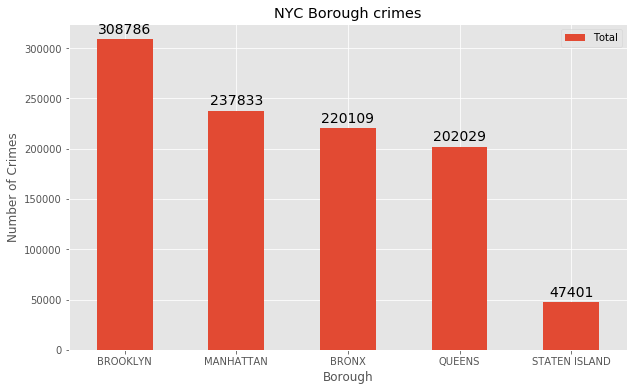

In [46]:
Newyork_crime.sort_values(['Total'], ascending = False, axis = 0, inplace = True )

df_sorted_2 = Newyork_crime.head() 

df_2 = df_sorted_2[['Borough Name','Total']]

df_2.set_index('Borough Name',inplace = True)

ax = df_2.plot(kind='bar', figsize=(10, 6), rot=0)

ax.set_ylabel('Number of Crimes') # add to x-label to the plot
ax.set_xlabel('Borough') # add y-label to the plot
ax.set_title('NYC Borough crimes') # add title to the plot

# Creating a function to display the percentage.

for p in ax.patches:
    ax.annotate(np.round(p.get_height(),decimals=2), 
                (p.get_x()+p.get_width()/2., p.get_height()), 
                ha='center', 
                va='center', 
                xytext=(0, 10), 
                textcoords='offset points',
                fontsize = 14
               )

plt.show()

When we look at this graph, we can see that Brooklyn has the most amount of crimes. Staten Island is much lower, almost 5 times less than Brooklyn. However, this could be misleading. Staten Island is the borough with the least amount of people, hence the decreased offense. Brooklyn is the borough with the biggest population. However, since this data is aggregate data of many years and the population number is per year, taking the total amount of offense divided by census data would not be a good indicator of crime per population. 

In [47]:
Newyork_crime_2.sort_values(['Total'], ascending = False, axis = 0, inplace = True )

df_top5_low = Newyork_crime_2.tail() 
df_top5_low

,name,No_of_CrimesABORTION,No_of_CrimesADMINISTRATIVE CODE,No_of_CrimesADMINISTRATIVE CODES,No_of_CrimesAGRICULTURE & MRKTS LAW-UNCLASSIFIED,No_of_CrimesALCOHOLIC BEVERAGE CONTROL LAW,No_of_CrimesANTICIPATORY OFFENSES,No_of_CrimesARSON,No_of_CrimesASSAULT 3 & RELATED OFFENSES,No_of_CrimesBURGLAR'S TOOLS,No_of_CrimesBURGLARY,No_of_CrimesCHILD ABANDONMENT/NON SUPPORT,No_of_CrimesCRIMINAL MISCHIEF & RELATED OF,No_of_CrimesCRIMINAL TRESPASS,No_of_CrimesDANGEROUS DRUGS,No_of_CrimesDANGEROUS WEAPONS,No_of_CrimesDISORDERLY CONDUCT,No_of_CrimesDISRUPTION OF A RELIGIOUS SERV,No_of_CrimesENDAN WELFARE INCOMP,No_of_CrimesESCAPE 3,No_of_CrimesFELONY ASSAULT,No_of_CrimesFORGERY,No_of_CrimesFORTUNE TELLING,No_of_CrimesFRAUDS,No_of_CrimesFRAUDULENT ACCOSTING,No_of_CrimesGAMBLING,No_of_CrimesGRAND LARCENY,No_of_CrimesGRAND LARCENY OF MOTOR VEHICLE,No_of_CrimesHARRASSMENT 2,"No_of_CrimesHOMICIDE-NEGLIGENT,UNCLASSIFIE",No_of_CrimesHOMICIDE-NEGLIGENT-VEHICLE,No_of_CrimesINTOXICATED & IMPAIRED DRIVING,No_of_CrimesINTOXICATED/IMPAIRED DRIVING,No_of_CrimesJOSTLING,No_of_CrimesKIDNAPPING,No_of_CrimesKIDNAPPING & RELATED OFFENSES,No_of_CrimesKIDNAPPING AND RELATED OFFENSES,No_of_CrimesLOITERING,No_of_CrimesLOITERING FOR DRUG PURPOSES,"No_of_CrimesLOITERING/GAMBLING (CARDS, DIC",No_of_CrimesMISCELLANEOUS PENAL LAW,No_of_CrimesMURDER & NON-NEGL. MANSLAUGHTER,No_of_CrimesNEW YORK CITY HEALTH CODE,No_of_CrimesNYS LAWS-UNCLASSIFIED FELONY,No_of_CrimesNYS LAWS-UNCLASSIFIED VIOLATION,No_of_CrimesOFF. AGNST PUB ORD SENSBLTY &,No_of_CrimesOFFENSES AGAINST PUBLIC ADMINI,No_of_CrimesOFFENSES AGAINST PUBLIC SAFETY,No_of_CrimesOFFENSES AGAINST THE PERSON,No_of_CrimesOFFENSES INVOLVING FRAUD,No_of_CrimesOFFENSES RELATED TO CHILDREN,No_of_CrimesOTHER OFFENSES RELATED TO THEF,No_of_CrimesOTHER STATE LAWS,No_of_CrimesOTHER STATE LAWS (NON PENAL LA,No_of_CrimesOTHER STATE LAWS (NON PENAL LAW),No_of_CrimesOTHER TRAFFIC INFRACTION,No_of_CrimesPETIT LARCENY,No_of_CrimesPETIT LARCENY OF MOTOR VEHICLE,No_of_CrimesPOSSESSION OF STOLEN PROPERTY,No_of_CrimesPROSTITUTION & RELATED OFFENSES,No_of_CrimesROBBERY,No_of_CrimesSEX CRIMES,No_of_CrimesTHEFT OF SERVICES,No_of_CrimesTHEFT-FRAUD,No_of_CrimesUNAUTHORIZED USE OF A VEHICLE,No_of_CrimesUNDER THE INFLUENCE OF DRUGS,No_of_CrimesUNLAWFUL POSS. WEAP. ON SCHOOL,No_of_CrimesVEHICLE AND TRAFFIC LAWS,No_of_Crimesnan,Total
15,Floral Park,0,0,0,0,0,0,0,10,0,6,0,14,0,1,1,0,0,0,0,7,0,0,0,0,0,16,6,18,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,12,2,0,0,0,0,0,0,0,0,0,11,0,0,0,1,0,0,3,1,0,0,1,0,112
22,Kings Point,0,0,0,0,0,0,0,11,0,8,0,21,0,0,0,0,0,0,0,2,0,0,0,0,0,10,5,16,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,6,7,0,0,0,0,1,0,0,0,0,12,0,1,0,2,0,0,2,0,0,0,0,1,107
24,Lawrence,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,2,0,0,2,0,0,8,4,1,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,22,0,0,0,0,0,0,1,3,0,0,0,0,49
38,Valley Stream,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,2,0,5,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,15
36,Union Beach,0,0,0,0,0,0,0,2,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,9


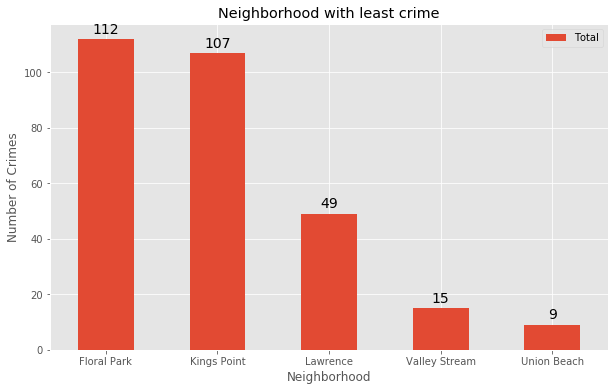

In [48]:
df_3 = df_top5_low[['name','Total']]

df_3.set_index('name',inplace = True)

ax = df_3.plot(kind='bar', figsize=(10, 6), rot=0)

ax.set_ylabel('Number of Crimes') # add to x-label to the plot
ax.set_xlabel('Neighborhood') # add y-label to the plot
ax.set_title('Neighborhood with least crime') # add title to the plot

# Creating a function to display the percentage.

for p in ax.patches:
    ax.annotate(np.round(p.get_height(),decimals=2), 
                (p.get_x()+p.get_width()/2., p.get_height()), 
                ha='center', 
                va='center', 
                xytext=(0, 10), 
                textcoords='offset points',
                fontsize = 14
               )

plt.show()

I graphed the neighborhoods with least crime. These neighborhoods are all part of Long Island, NY. For those of you who don't live in New York the city is divided into five boroughs, and Long Island is not one of the five borough but it shares a border with Queens and part of NY state. Thus, many of the calls from Long Island would made it into nyc data cause of proximity. However, these neighborhoods would be considered 'bigger metro nyc area'.

In [49]:
Newyork_crime_2.sort_values(['Total'], ascending = False, axis = 0, inplace = True )

df_top5_high = Newyork_crime_2.head() 
df_top5_high

,name,No_of_CrimesABORTION,No_of_CrimesADMINISTRATIVE CODE,No_of_CrimesADMINISTRATIVE CODES,No_of_CrimesAGRICULTURE & MRKTS LAW-UNCLASSIFIED,No_of_CrimesALCOHOLIC BEVERAGE CONTROL LAW,No_of_CrimesANTICIPATORY OFFENSES,No_of_CrimesARSON,No_of_CrimesASSAULT 3 & RELATED OFFENSES,No_of_CrimesBURGLAR'S TOOLS,No_of_CrimesBURGLARY,No_of_CrimesCHILD ABANDONMENT/NON SUPPORT,No_of_CrimesCRIMINAL MISCHIEF & RELATED OF,No_of_CrimesCRIMINAL TRESPASS,No_of_CrimesDANGEROUS DRUGS,No_of_CrimesDANGEROUS WEAPONS,No_of_CrimesDISORDERLY CONDUCT,No_of_CrimesDISRUPTION OF A RELIGIOUS SERV,No_of_CrimesENDAN WELFARE INCOMP,No_of_CrimesESCAPE 3,No_of_CrimesFELONY ASSAULT,No_of_CrimesFORGERY,No_of_CrimesFORTUNE TELLING,No_of_CrimesFRAUDS,No_of_CrimesFRAUDULENT ACCOSTING,No_of_CrimesGAMBLING,No_of_CrimesGRAND LARCENY,No_of_CrimesGRAND LARCENY OF MOTOR VEHICLE,No_of_CrimesHARRASSMENT 2,"No_of_CrimesHOMICIDE-NEGLIGENT,UNCLASSIFIE",No_of_CrimesHOMICIDE-NEGLIGENT-VEHICLE,No_of_CrimesINTOXICATED & IMPAIRED DRIVING,No_of_CrimesINTOXICATED/IMPAIRED DRIVING,No_of_CrimesJOSTLING,No_of_CrimesKIDNAPPING,No_of_CrimesKIDNAPPING & RELATED OFFENSES,No_of_CrimesKIDNAPPING AND RELATED OFFENSES,No_of_CrimesLOITERING,No_of_CrimesLOITERING FOR DRUG PURPOSES,"No_of_CrimesLOITERING/GAMBLING (CARDS, DIC",No_of_CrimesMISCELLANEOUS PENAL LAW,No_of_CrimesMURDER & NON-NEGL. MANSLAUGHTER,No_of_CrimesNEW YORK CITY HEALTH CODE,No_of_CrimesNYS LAWS-UNCLASSIFIED FELONY,No_of_CrimesNYS LAWS-UNCLASSIFIED VIOLATION,No_of_CrimesOFF. AGNST PUB ORD SENSBLTY &,No_of_CrimesOFFENSES AGAINST PUBLIC ADMINI,No_of_CrimesOFFENSES AGAINST PUBLIC SAFETY,No_of_CrimesOFFENSES AGAINST THE PERSON,No_of_CrimesOFFENSES INVOLVING FRAUD,No_of_CrimesOFFENSES RELATED TO CHILDREN,No_of_CrimesOTHER OFFENSES RELATED TO THEF,No_of_CrimesOTHER STATE LAWS,No_of_CrimesOTHER STATE LAWS (NON PENAL LA,No_of_CrimesOTHER STATE LAWS (NON PENAL LAW),No_of_CrimesOTHER TRAFFIC INFRACTION,No_of_CrimesPETIT LARCENY,No_of_CrimesPETIT LARCENY OF MOTOR VEHICLE,No_of_CrimesPOSSESSION OF STOLEN PROPERTY,No_of_CrimesPROSTITUTION & RELATED OFFENSES,No_of_CrimesROBBERY,No_of_CrimesSEX CRIMES,No_of_CrimesTHEFT OF SERVICES,No_of_CrimesTHEFT-FRAUD,No_of_CrimesUNAUTHORIZED USE OF A VEHICLE,No_of_CrimesUNDER THE INFLUENCE OF DRUGS,No_of_CrimesUNLAWFUL POSS. WEAP. ON SCHOOL,No_of_CrimesVEHICLE AND TRAFFIC LAWS,No_of_Crimesnan,Total
7,Brooklyn,0,402,0,5,4,1,277,14599,39,4968,6,11935,838,5984,2262,20,0,7,0,5883,1603,0,845,2,34,10096,2085,17535,0,0,1689,1,2,1,45,0,0,0,6,4719,134,1,153,0,5418,1623,16,245,222,39,376,5,47,0,2,19091,39,586,3,5361,0,33,1201,582,0,0,1420,265,122755
35,The Bronx,0,250,0,16,33,1,403,14506,39,3285,10,11265,868,9370,2825,11,0,4,3,6460,1082,0,637,21,112,6731,1704,14390,2,0,1106,2,2,0,45,0,0,0,0,2575,74,1,131,2,5352,3902,17,392,248,20,283,2,164,0,1,15266,8,359,32,4553,22,72,874,281,0,0,1435,285,111534
20,Inwood,1,202,0,17,36,1,303,14484,48,3012,7,10594,1495,10140,3982,26,0,8,3,5832,1197,0,797,20,114,6832,1353,14284,1,0,1313,1,2,0,34,0,0,0,1,2779,117,1,100,0,4683,2704,49,381,388,112,342,4,137,0,0,15921,9,441,96,4351,0,144,984,271,0,0,892,276,111322
26,Manhattan,0,99,0,6,3,3,217,8772,87,2244,4,8268,1924,6519,1835,10,4,3,1,3159,1125,0,957,155,114,12827,642,11229,0,0,740,2,18,0,23,1,1,0,2,1863,41,8,43,0,3614,2311,10,278,265,5,297,4,126,0,0,20548,12,529,20,2755,0,295,1310,137,0,3,802,386,96656
28,New York City,0,57,0,6,1,0,193,6893,200,2527,4,7404,889,3568,1375,7,3,5,3,2413,842,0,633,92,16,14302,739,9345,0,1,863,0,16,0,16,0,0,0,1,1709,28,1,138,0,2856,1521,11,259,973,4,294,1,296,0,0,23167,10,697,4,2134,0,105,992,120,0,3,789,318,88844


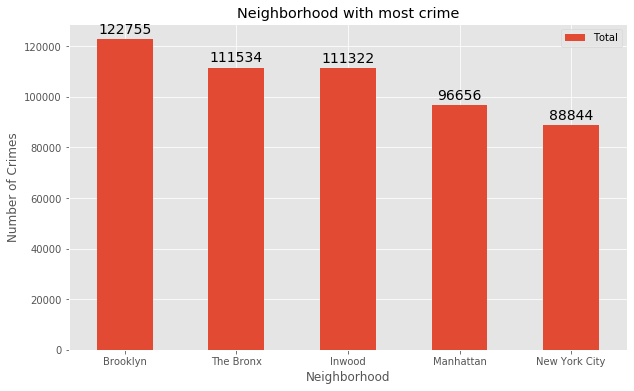

In [50]:
df_4 = df_top5_high[['name','Total']]

df_4.set_index('name',inplace = True)

ax = df_4.plot(kind='bar', figsize=(10, 6), rot=0)

ax.set_ylabel('Number of Crimes') # add to x-label to the plot
ax.set_xlabel('Neighborhood') # add y-label to the plot
ax.set_title('Neighborhood with most crime') # add title to the plot

# Creating a function to display the percentage.

for p in ax.patches:
    ax.annotate(np.round(p.get_height(),decimals=2), 
                (p.get_x()+p.get_width()/2., p.get_height()), 
                ha='center', 
                va='center', 
                xytext=(0, 10), 
                textcoords='offset points',
                fontsize = 14
               )

plt.show()

As I said, the rg geocode is not perfect. The neighborhood division is not perfect, reflected by the two 'Manhattan' and 'New York City' category. It's confusing and misleading. Inwood is a specfic neighborhood in Upper Manhattan. 

In [77]:
Newyork_crime_premise.sort_values(['Total'], ascending = False, axis = 0, inplace = True )

df_top5_high_2 = Newyork_crime_premise.head() 
df_top5_high_2

,Premise Description,No_of_CrimesBRONX,No_of_CrimesBROOKLYN,No_of_CrimesMANHATTAN,No_of_CrimesQUEENS,No_of_CrimesSTATEN ISLAND,Total
58,STREET,75009,100473,61425,64282,11106,312295
49,RESIDENCE - APT. HOUSE,61103,74141,44357,36732,6299,222632
51,RESIDENCE-HOUSE,10893,29438,1045,39187,14601,95164
50,RESIDENCE - PUBLIC HOUSING,20114,26140,23535,5813,2249,77851
40,OTHER,7026,8303,5849,5086,1599,27863


In [62]:
df_top5_high_2.columns

Index(['No_of_CrimesBRONX', 'No_of_CrimesBROOKLYN', 'No_of_CrimesMANHATTAN',
       'No_of_CrimesQUEENS', 'No_of_CrimesSTATEN ISLAND', 'Total'],
      dtype='object')

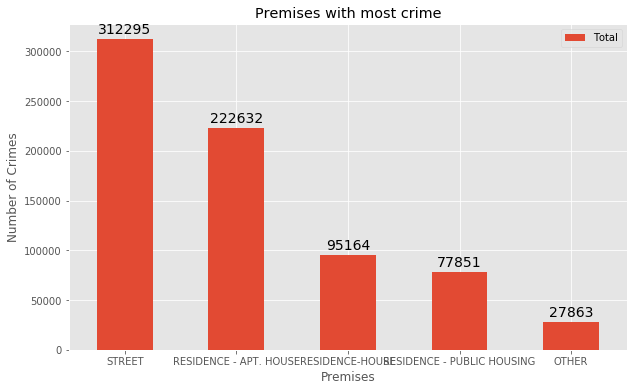

In [78]:
df_4 = df_top5_high_2[['Premise Description','Total']]

df_4.set_index('Premise Description',inplace = True)

ax = df_4.plot(kind='bar', figsize=(10, 6), rot=0)

ax.set_ylabel('Number of Crimes') # add to x-label to the plot
ax.set_xlabel('Premises') # add y-label to the plot
ax.set_title('Premises with most crime') # add title to the plot

# Creating a function to display the percentage.

for p in ax.patches:
    ax.annotate(np.round(p.get_height(),decimals=2), 
                (p.get_x()+p.get_width()/2., p.get_height()), 
                ha='center', 
                va='center', 
                xytext=(0, 10), 
                textcoords='offset points',
                fontsize = 14
               )

plt.show()

In [86]:
df['Premise Condition']=df['Premise Description'].astype(str)

In [88]:
df = df.dropna(subset=['Premise Description'], axis=0,how='any')



In [95]:
df['Premise Description'].value_counts()

STREET                          312295
RESIDENCE - APT. HOUSE          222632
RESIDENCE-HOUSE                  95164
RESIDENCE - PUBLIC HOUSING       77851
OTHER                            27863
COMMERCIAL BUILDING              26719
CHAIN STORE                      23968
DEPARTMENT STORE                 22947
TRANSIT - NYC SUBWAY             21871
GROCERY/BODEGA                   15217
RESTAURANT/DINER                 13221
BAR/NIGHT CLUB                   12241
PARK/PLAYGROUND                  12022
PUBLIC SCHOOL                    10438
CLOTHING/BOUTIQUE                 9644
DRUG STORE                        9267
FOOD SUPERMARKET                  6356
PUBLIC BUILDING                   6321
FAST FOOD                         5876
PARKING LOT/GARAGE (PRIVATE)      5018
PARKING LOT/GARAGE (PUBLIC)       4995
HOSPITAL                          4890
HOTEL/MOTEL                       4519
SMALL MERCHANT                    4272
STORE UNCLASSIFIED                4260
BANK                     

As we can see, the offenses often takes place in an apartment or a street. However, if we want to compare this data against popular venues in NYC generated by Foursquare API, we are more interested in places such as yoga, cafe, brunch spots... so we will remove some category of places of offenses from the dataframe. 

In [196]:
searchfor = ['STREE', 'HOUS','RESIDENCE','OTHER','COMMERCIAL','TRANSIT']
df_2 = df[~df['Premise Condition'].str.contains('|'.join(searchfor))]

In [197]:
df_2.head()

,Complaint From Date,Report Date,Offense Classification Code,Offense Description,Crime successfully completed,Level of offense,Jurisdiction Description,Borough Name,Precinct,Location of Occurence,Premise Description,X coordinate,Y coordinate,Latitude,Longitude,name,No_of_Crimes,Premise Condition
0,12/31/2015,12/31/2015,113,FORGERY,COMPLETED,FELONY,N.Y. POLICE DEPT,BRONX,44.0,INSIDE,BAR/NIGHT CLUB,1007314.0,241257.0,40.828848,-73.916661,Inwood,1,BAR/NIGHT CLUB
5,12/31/2015,12/31/2015,106,FELONY ASSAULT,ATTEMPTED,FELONY,N.Y. POLICE DEPT,BROOKLYN,71.0,FRONT OF,DRUG STORE,996149.0,181562.0,40.665023,-73.957111,Brooklyn,1,DRUG STORE
9,12/31/2015,12/31/2015,341,PETIT LARCENY,COMPLETED,MISDEMEANOR,N.Y. POLICE DEPT,MANHATTAN,19.0,INSIDE,DRUG STORE,994327.0,218211.0,40.765618,-73.963623,Manhattan,1,DRUG STORE
10,12/31/2015,12/31/2015,341,PETIT LARCENY,COMPLETED,MISDEMEANOR,N.Y. POLICE DEPT,BRONX,41.0,INSIDE,FAST FOOD,1014216.0,238784.0,40.822040,-73.891732,The Bronx,1,FAST FOOD
11,12/31/2015,12/31/2015,341,PETIT LARCENY,COMPLETED,MISDEMEANOR,N.Y. POLICE DEPT,MANHATTAN,13.0,INSIDE,RESTAURANT/DINER,988113.0,206263.0,40.732828,-73.986063,New York City,1,RESTAURANT/DINER


In [198]:
Newyork_crime_premise_2 = pd.pivot_table(df_2,values=['No_of_Crimes'],
                               index=['Premise Description'],
                               columns=['Borough Name'],
                               aggfunc=np.sum,fill_value=0)
Newyork_crime_premise_2.head()

No_of_Crimes                                        
Borough Name               BRONX BROOKLYN MANHATTAN QUEENS STATEN ISLAND
Premise Description                                                     
ABANDONED BUILDING            57      155       146    171            55
AIRPORT TERMINAL               1        5         3   1434             4
ATM                          112      292       314    160            36
BANK                         621      899      1688    815           152
BAR/NIGHT CLUB               819     2198      6652   2328           244

In [199]:
# Reset the index
Newyork_crime_premise_2.reset_index(inplace = True)

In [200]:
# Total crimes per Borough
Newyork_crime_premise_2['Total'] = Newyork_crime_premise_2.sum(axis=1)
Newyork_crime_premise_2.head()

Premise Description No_of_Crimes                            \
Borough Name                            BRONX BROOKLYN MANHATTAN QUEENS   
0             ABANDONED BUILDING           57      155       146    171   
1               AIRPORT TERMINAL            1        5         3   1434   
2                            ATM          112      292       314    160   
3                           BANK          621      899      1688    815   
4                 BAR/NIGHT CLUB          819     2198      6652   2328   

                            Total  
Borough Name STATEN ISLAND         
0                       55    584  
1                        4   1447  
2                       36    914  
3                      152   4175  
4                      244  12241

In [201]:
Newyork_crime_premise_2.columns = Newyork_crime_premise.columns.map(''.join)
Newyork_crime_premise_2.head()

,Premise Description,No_of_CrimesBRONX,No_of_CrimesBROOKLYN,No_of_CrimesMANHATTAN,No_of_CrimesQUEENS,No_of_CrimesSTATEN ISLAND,Total
0,ABANDONED BUILDING,57,155,146,171,55,584
1,AIRPORT TERMINAL,1,5,3,1434,4,1447
2,ATM,112,292,314,160,36,914
3,BANK,621,899,1688,815,152,4175
4,BAR/NIGHT CLUB,819,2198,6652,2328,244,12241


In [202]:
Newyork_crime_premise_2.sort_values(['Total'], ascending = False, axis = 0, inplace = True )

df_top5_high_3 = Newyork_crime_premise_2.head() 
df_top5_high_3

,Premise Description,No_of_CrimesBRONX,No_of_CrimesBROOKLYN,No_of_CrimesMANHATTAN,No_of_CrimesQUEENS,No_of_CrimesSTATEN ISLAND,Total
12,CHAIN STORE,3493,5778,9745,3901,1051,23968
17,DEPARTMENT STORE,3788,4737,8480,4673,1269,22947
25,GROCERY/BODEGA,3336,5573,3113,2521,674,15217
43,RESTAURANT/DINER,1305,2862,6601,2048,405,13221
4,BAR/NIGHT CLUB,819,2198,6652,2328,244,12241


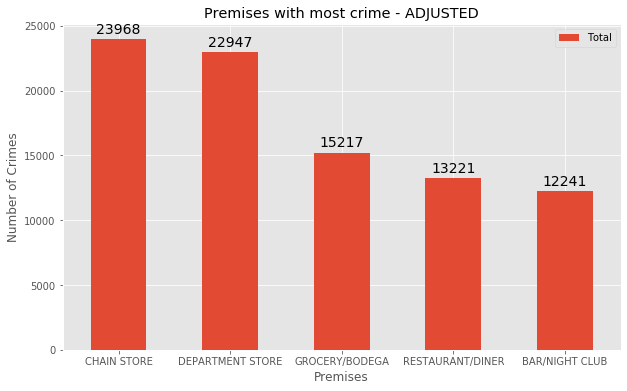

In [203]:
df_5 = df_top5_high_3[['Premise Description','Total']]

df_5.set_index('Premise Description',inplace = True)

ax = df_5.plot(kind='bar', figsize=(10, 6), rot=0)

ax.set_ylabel('Number of Crimes') # add to x-label to the plot
ax.set_xlabel('Premises') # add y-label to the plot
ax.set_title('Premises with most crime - ADJUSTED') # add title to the plot

# Creating a function to display the percentage.

for p in ax.patches:
    ax.annotate(np.round(p.get_height(),decimals=2), 
                (p.get_x()+p.get_width()/2., p.get_height()), 
                ha='center', 
                va='center', 
                xytext=(0, 10), 
                textcoords='offset points',
                fontsize = 14
               )

plt.show()

After removing residential building and ambigious values, we got our top 5 places with most crime occurences in NYC. We could cross-match this against our clusters and their most popular venues. 
However, Our focus will be on Manhattan since the only part of NYC clustered is Manhattan. 

In [204]:
Manhattan_crime_premise=Newyork_crime_premise_2[['Premise Description','No_of_CrimesMANHATTAN']]

In [205]:
Manhattan_crime_premise.head()

,Premise Description,No_of_CrimesMANHATTAN
12,CHAIN STORE,9745
17,DEPARTMENT STORE,8480
25,GROCERY/BODEGA,3113
43,RESTAURANT/DINER,6601
4,BAR/NIGHT CLUB,6652


In [206]:
Manhattan_crime_premise.sort_values(['No_of_CrimesMANHATTAN'], ascending = False, axis = 0, inplace = True )

df_top5_manhattan = Manhattan_crime_premise.head(10) 
df_top5_manhattan

/Users/baongocdinh/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,Premise Description,No_of_CrimesMANHATTAN
12,CHAIN STORE,9745
17,DEPARTMENT STORE,8480
4,BAR/NIGHT CLUB,6652
43,RESTAURANT/DINER,6601
15,CLOTHING/BOUTIQUE,6514
36,PARK/PLAYGROUND,3891
19,DRUG STORE,3517
25,GROCERY/BODEGA,3113
29,HOTEL/MOTEL,2905
21,FAST FOOD,2142


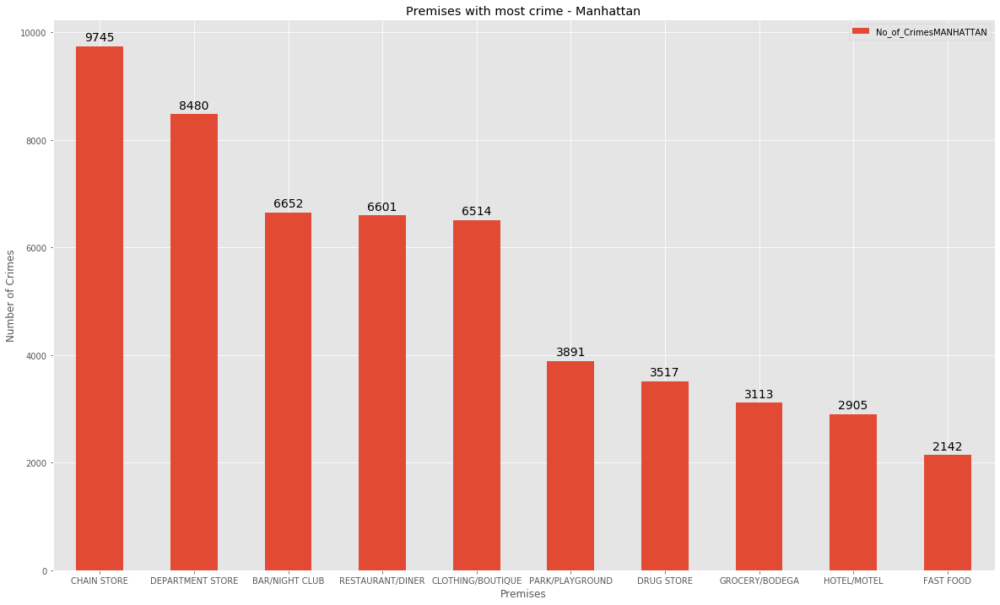

In [208]:
df_top5_manhattan.set_index('Premise Description',inplace = True)

ax = df_top5_manhattan.plot(kind='bar', figsize=(20,12), rot=0)

ax.set_ylabel('Number of Crimes') # add to x-label to the plot
ax.set_xlabel('Premises') # add y-label to the plot
ax.set_title('Premises with most crime - Manhattan') # add title to the plot

# Creating a function to display the percentage.

for p in ax.patches:
    ax.annotate(np.round(p.get_height(),decimals=2), 
                (p.get_x()+p.get_width()/2., p.get_height()), 
                ha='center', 
                va='center', 
                xytext=(0, 10), 
                textcoords='offset points',
                fontsize = 14
               )

plt.show()

Since our cluster produces 10 most popular venues in the area, we are going to cross match the 10 premises with most crimes against the 10 most popular venues in the area.

## NYC CRIME MAP

In [186]:
import folium
import sys
 
NY_COORDINATES = (40.7128, -74.0060)

In [187]:
map = folium.Map(location=NY_COORDINATES, zoom_start=12)

In [188]:
from folium.plugins import MarkerCluster
mc = MarkerCluster().add_to(map)

In [189]:
for each in df[0:50000].iterrows():
    folium.Marker([each[1]['Latitude'],each[1]['Longitude']]).add_to(mc)

In [190]:
map

I created a map of NYC Crimes. the color indicates the severity of crime in the neighborhood. There are some neighborhoods that have more crimes than other. Due to my limited computing power, I only chose the first 50,000 rows. The whole dataset has at least 10x more data.
<li>Upper Manhattan has a heavy concentration of crime, which makes sense since our bar charts indicated the same thing.</li>
<li>Less incidents occur in deep Queens and Long Island, which also go with our bar chart results.</li>


## Manhattan Focus

In [148]:
address = 'New York City, NY'

geolocator = Nominatim()
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of New York City are {}, {}.'.format(latitude, longitude))

/Users/baongocdinh/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: Using Nominatim with the default "geopy/1.20.0" `user_agent` is strongly discouraged, as it violates Nominatim's ToS https://operations.osmfoundation.org/policies/nominatim/ and may possibly cause 403 and 429 HTTP errors. Please specify a custom `user_agent` with `Nominatim(user_agent="my-application")` or by overriding the default `user_agent`: `geopy.geocoders.options.default_user_agent = "my-application"`. In geopy 2.0 this will become an exception.
  This is separate from the ipykernel package so we can avoid doing imports until


The geograpical coordinate of New York City are 40.7127281, -74.0060152.


In [150]:
# type your answer here


LIMIT = 100 # limit of number of venues returned by Foursquare API



radius = 500 # define radius



# create URL
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    latitude, 
    longitude, 
    radius, 
    LIMIT)
url # display URL


'https://api.foursquare.com/v2/venues/explore?&client_id=PR5IHUD5WXBUSX1XXQSNAXUEL0GQBXPDICHXCLLOXYCTMWJC&client_secret=IB5FABAMKAVKYYHXBFLLFODFFURIWVMGIIFXDFP4AWDACUF2&v=20200101&ll=40.7127281,-74.0060152&radius=500&limit=100'

In [151]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5e3bc0b70de0d9001bc7c527'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'},
    {'name': '$-$$$$', 'key': 'price'}]},
  'headerLocation': 'Downtown Manhattan',
  'headerFullLocation': 'Downtown Manhattan, New York',
  'headerLocationGranularity': 'neighborhood',
  'totalResults': 165,
  'suggestedBounds': {'ne': {'lat': 40.7172281045, 'lng': -74.00008952063419},
   'sw': {'lat': 40.7082280955, 'lng': -74.0119408793658}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '57f0689d498e7d49d9189369',
       'name': 'The Bar Room at Temple Court',
       'location': {'address': '123 Nassau St',
        'lat': 40.7114477287544,
        'lng': -74.00680157032005,
        'labe

In [152]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [153]:
venues = results['response']['groups'][0]['items']
    
nearby_venues = json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head()

,name,categories,lat,lng
0,The Bar Room at Temple Court,Hotel Bar,40.711448,-74.006802
1,The Beekman – A Thompson Hotel,Hotel,40.711173,-74.006702
2,Alba Dry Cleaner & Tailor,Laundry Service,40.711434,-74.006272
3,City Hall Park,Park,40.712415,-74.006724
4,Gibney Dance Center Downtown,Dance Studio,40.713923,-74.005661


In [154]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

100 venues were returned by Foursquare.


In [155]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            latitude, 
            longitude, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            latitude, 
            longitude, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [156]:
import json
with open('nyu_2451_34572-geojson.json') as json_data:
    newyork_data = json.load(json_data)

In [157]:
neighborhoods_data = newyork_data['features']

In [158]:
# define the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
neighborhoods = pd.DataFrame(columns=column_names)

In [159]:
for data in neighborhoods_data:
    borough = neighborhood_name = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    neighborhoods = neighborhoods.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)

In [160]:
# type your answer here

nyc_venues = getNearbyVenues(names=neighborhoods['Neighborhood'],
                                   latitudes=neighborhoods['Latitude'],
                                   longitudes=neighborhoods['Longitude']
                                  )




Wakefield
Co-op City
Eastchester
Fieldston
Riverdale
Kingsbridge
Marble Hill
Woodlawn
Norwood
Williamsbridge
Baychester
Pelham Parkway
City Island
Bedford Park
University Heights
Morris Heights
Fordham
East Tremont
West Farms
High  Bridge
Melrose
Mott Haven
Port Morris
Longwood
Hunts Point
Morrisania
Soundview
Clason Point
Throgs Neck
Country Club
Parkchester
Westchester Square
Van Nest
Morris Park
Belmont
Spuyten Duyvil
North Riverdale
Pelham Bay
Schuylerville
Edgewater Park
Castle Hill
Olinville
Pelham Gardens
Concourse
Unionport
Edenwald
Bay Ridge
Bensonhurst
Sunset Park
Greenpoint
Gravesend
Brighton Beach
Sheepshead Bay
Manhattan Terrace
Flatbush
Crown Heights
East Flatbush
Kensington
Windsor Terrace
Prospect Heights
Brownsville
Williamsburg
Bushwick
Bedford Stuyvesant
Brooklyn Heights
Cobble Hill
Carroll Gardens
Red Hook
Gowanus
Fort Greene
Park Slope
Cypress Hills
East New York
Starrett City
Canarsie
Flatlands
Mill Island
Manhattan Beach
Coney Island
Bath Beach
Borough Park
Dyker

KeyError: 'groups'

In [162]:
# create map of New York using latitude and longitude values
map_newyork = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(neighborhoods['Latitude'], neighborhoods['Longitude'], neighborhoods['Borough'], neighborhoods['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_newyork)  
    
map_newyork

In [161]:
manhattan_data = neighborhoods[neighborhoods['Borough'] == 'Manhattan'].reset_index(drop=True)
manhattan_data.head()

,Borough,Neighborhood,Latitude,Longitude
0,Manhattan,Marble Hill,40.876551,-73.910660
1,Manhattan,Chinatown,40.715618,-73.994279
2,Manhattan,Washington Heights,40.851903,-73.936900
3,Manhattan,Inwood,40.867684,-73.921210
4,Manhattan,Hamilton Heights,40.823604,-73.949688


In [163]:
address = 'Manhattan, NY'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Manhattan are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Manhattan are 40.7896239, -73.9598939.


In [164]:
# create map of Manhattan using latitude and longitude values
map_manhattan = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, label in zip(manhattan_data['Latitude'], manhattan_data['Longitude'], manhattan_data['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_manhattan)  
    
map_manhattan

## Exploring Manhattan

In [165]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [166]:
# type your answer here

manhattan_venues = getNearbyVenues(names=manhattan_data['Neighborhood'],
                                   latitudes=manhattan_data['Latitude'],
                                   longitudes=manhattan_data['Longitude']
                                  )




Marble Hill
Chinatown
Washington Heights
Inwood
Hamilton Heights
Manhattanville
Central Harlem
East Harlem
Upper East Side
Yorkville
Lenox Hill
Roosevelt Island
Upper West Side
Lincoln Square
Clinton
Midtown
Murray Hill
Chelsea
Greenwich Village
East Village
Lower East Side
Tribeca
Little Italy
Soho
West Village
Manhattan Valley
Morningside Heights
Gramercy
Battery Park City
Financial District
Carnegie Hill
Noho
Civic Center
Midtown South
Sutton Place
Turtle Bay
Tudor City
Stuyvesant Town
Flatiron
Hudson Yards


In [167]:
print(manhattan_venues.shape)
manhattan_venues.head()

(3310, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Marble Hill,40.876551,-73.91066,Arturo's,40.874412,-73.910271,Pizza Place
1,Marble Hill,40.876551,-73.91066,Bikram Yoga,40.876844,-73.906204,Yoga Studio
2,Marble Hill,40.876551,-73.91066,Tibbett Diner,40.880404,-73.908937,Diner
3,Marble Hill,40.876551,-73.91066,Starbucks,40.877531,-73.905582,Coffee Shop
4,Marble Hill,40.876551,-73.91066,Dunkin',40.877136,-73.906666,Donut Shop


In [168]:
manhattan_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Battery Park City,96,96,96,96,96,96
Carnegie Hill,100,100,100,100,100,100
Central Harlem,45,45,45,45,45,45
Chelsea,100,100,100,100,100,100
Chinatown,100,100,100,100,100,100
Civic Center,100,100,100,100,100,100
Clinton,100,100,100,100,100,100
East Harlem,41,41,41,41,41,41
East Village,100,100,100,100,100,100


In [169]:
# one hot encoding
manhattan_onehot = pd.get_dummies(manhattan_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
manhattan_onehot['Neighborhood'] = manhattan_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [manhattan_onehot.columns[-1]] + list(manhattan_onehot.columns[:-1])
manhattan_onehot = manhattan_onehot[fixed_columns]

manhattan_onehot.head()

,Neighborhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,Auto Workshop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Basketball Court,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Bridal Shop,Bridge,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Candy Store,Caribbean Restaurant,Caucasian Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Christmas Market,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Bookstore,College Cafeteria,College Theater,Comedy Club,Community Center,Concert Hall,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish Market,Flea Market,Flower Shop,Food & Drink Shop,Food Court,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Laundry Service,Leather Goods Store,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Museum,Music School,Music Venue,Nail Salon,New American Restaurant,Newsstand,Nightclub,Non-Profit,Noodle House,Office,Opera House,Optical Shop,Organic Grocery,Other Great Outdoors,Outdoor Sculpture,Outdoors & Recreation,Paella Restaurant,Paper / Office Supplies Store,Park,Pedestrian Plaza,Performing Arts Venue,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Photography Studio,Physical Therapist,Pie Shop,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pub,Public Art,Ramen Restaurant,Record Shop,Recreation Center,Rental Car Location,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,Rock Climbing Spot,Rock Club,Roof Deck,Russian Restaurant,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,School,Sculpture Garden,Seafood Restaurant,Shanghai Restaurant,Shipping Store,Shoe Store,Shopping Mall,Skate Park,Skating Rink,Smoke S

In [170]:
manhattan_grouped = manhattan_onehot.groupby('Neighborhood').mean().reset_index()
manhattan_grouped

,Neighborhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,Auto Workshop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Basketball Court,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Bridal Shop,Bridge,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Candy Store,Caribbean Restaurant,Caucasian Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Christmas Market,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Bookstore,College Cafeteria,College Theater,Comedy Club,Community Center,Concert Hall,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish Market,Flea Market,Flower Shop,Food & Drink Shop,Food Court,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Laundry Service,Leather Goods Store,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Museum,Music School,Music Venue,Nail Salon,New American Restaurant,Newsstand,Nightclub,Non-Profit,Noodle House,Office,Opera House,Optical Shop,Organic Grocery,Other Great Outdoors,Outdoor Sculpture,Outdoors & Recreation,Paella Restaurant,Paper / Office Supplies Store,Park,Pedestrian Plaza,Performing Arts Venue,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Photography Studio,Physical Therapist,Pie Shop,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pub,Public Art,Ramen Restaurant,Record Shop,Recreation Center,Rental Car Location,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,Rock Climbing Spot,Rock Club,Roof Deck,Russian Restaurant,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,School,Sculpture Garden,Seafood Restaurant,Shanghai Restaurant,Shipping Store,Shoe Store,Shopping Mall,Skate Park,Skating Rink,Smoke S

In [171]:
num_top_venues = 5

for hood in manhattan_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = manhattan_grouped[manhattan_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Battery Park City----
           venue  freq
0           Park  0.07
1    Coffee Shop  0.07
2          Hotel  0.05
3            Gym  0.04
4  Women's Store  0.03


----Carnegie Hill----
               venue  freq
0        Coffee Shop  0.07
1        Pizza Place  0.06
2     Cosmetics Shop  0.04
3        Yoga Studio  0.03
4  French Restaurant  0.03


----Central Harlem----
                 venue  freq
0   African Restaurant  0.07
1   Chinese Restaurant  0.07
2  American Restaurant  0.04
3                  Bar  0.04
4   Seafood Restaurant  0.04


----Chelsea----
                venue  freq
0         Coffee Shop  0.06
1              Bakery  0.05
2  Italian Restaurant  0.05
3      Ice Cream Shop  0.04
4               Hotel  0.03


----Chinatown----
                   venue  freq
0     Chinese Restaurant  0.10
1           Cocktail Bar  0.04
2    American Restaurant  0.04
3  Vietnamese Restaurant  0.04
4      Hotpot Restaurant  0.03


----Civic Center----
                  venue  freq
0  Gym

In [172]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [173]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = manhattan_grouped['Neighborhood']

for ind in np.arange(manhattan_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(manhattan_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Battery Park City,Coffee Shop,Park,Hotel,Gym,Wine Shop,Women's Store,Memorial Site,Italian Restaurant,Pizza Place,Plaza
1,Carnegie Hill,Coffee Shop,Pizza Place,Cosmetics Shop,Japanese Restaurant,Gym,French Restaurant,Yoga Studio,Café,Bookstore,Wine Shop
2,Central Harlem,Chinese Restaurant,African Restaurant,French Restaurant,Cosmetics Shop,Seafood Restaurant,Bar,American Restaurant,Cafeteria,Bookstore,Gym / Fitness Center
3,Chelsea,Coffee Shop,Italian Restaurant,Bakery,Ice Cream Shop,Theater,American Restaurant,Hotel,Nightclub,Cupcake Shop,French Restaurant
4,Chinatown,Chinese Restaurant,Cocktail Bar,American Restaurant,Vietnamese Restaurant,Optical Shop,Spa,Bakery,Hotpot Restaurant,Salon / Barbershop,Noodle House


In [174]:
# set number of clusters
kclusters = 5

manhattan_grouped_clustering = manhattan_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(manhattan_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([3, 3, 0, 3, 0, 3, 3, 2, 0, 3], dtype=int32)

In [177]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

manhattan_merged = manhattan_data

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
manhattan_merged = manhattan_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

manhattan_merged.head() # check the last columns!

,Borough,Neighborhood,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Manhattan,Marble Hill,40.876551,-73.910660,2,Sandwich Place,Coffee Shop,Yoga Studio,Deli / Bodega,Supplement Shop,Steakhouse,Shopping Mall,Seafood Restaurant,Pizza Place,Department Store
1,Manhattan,Chinatown,40.715618,-73.994279,0,Chinese Restaurant,Cocktail Bar,American Restaurant,Vietnamese Restaurant,Optical Shop,Spa,Bakery,Hotpot Restaurant,Salon / Barbershop,Noodle House
2,Manhattan,Washington Heights,40.851903,-73.936900,2,Café,Bakery,Grocery Store,Mobile Phone Shop,Coffee Shop,Deli / Bodega,Mexican Restaurant,Latin American Restaurant,New American Restaurant,Park
3,Manhattan,Inwood,40.867684,-73.921210,2,Mexican Restaurant,Café,Restaurant,Lounge,Park,Chinese Restaurant,Deli / Bodega,Pharmacy,Wine Bar,Caribbean Restaurant
4,Manhattan,Hamilton Heights,40.823604,-73.949688,2,Pizza Place,Coffee Shop,Café,Deli / Bodega,Mexican Restaurant,Sandwich Place,Indian Restaurant,Sushi Restaurant,Park,Yoga Studio


In [178]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(manhattan_merged['Latitude'], manhattan_merged['Longitude'], manhattan_merged['Neighborhood'], manhattan_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

## Examine Clusters and Crime

According to the crime data, we know that Manhattan has some venues that have more crime incidents than others. We shall match those against the most common venues for each clusters and provide recommendation.

<p>The list of venues with most crimes in Manhattan</p>
<ol>Chain Store</ol>
<ol>Department Store</ol>
<ol>Bar/Night Club</ol>
<ol>Restaurant/Diner</ol>
<ol>Clothing/ Boutique</ol>
<ol>Park/Playground</ol>
<ol>Drug store</ol>
<ol>Grocery/bodega</ol>
<ol>Hotel/motel</ol>
<ol>Fast Food</ol>

In [209]:
manhattan_merged.loc[manhattan_merged['Cluster Labels'] == 0, manhattan_merged.columns[[1] + list(range(5, manhattan_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Chinatown,Chinese Restaurant,Cocktail Bar,American Restaurant,Vietnamese Restaurant,Optical Shop,Spa,Bakery,Hotpot Restaurant,Salon / Barbershop,Noodle House
6,Central Harlem,Chinese Restaurant,African Restaurant,French Restaurant,Cosmetics Shop,Seafood Restaurant,Bar,American Restaurant,Cafeteria,Bookstore,Gym / Fitness Center
9,Yorkville,Italian Restaurant,Coffee Shop,Bar,Gym,Pizza Place,Deli / Bodega,Wine Shop,Sushi Restaurant,Japanese Restaurant,Diner
12,Upper West Side,Italian Restaurant,Wine Bar,Bar,Coffee Shop,Indian Restaurant,Bakery,Café,Mediterranean Restaurant,Restaurant,Pub
19,East Village,Bar,Ice Cream Shop,Wine Bar,Pizza Place,Mexican Restaurant,Chinese Restaurant,Italian Restaurant,Speakeasy,Coffee Shop,Cocktail Bar
25,Manhattan Valley,Bar,Indian Restaurant,Coffee Shop,Playground,Pizza Place,Mexican Restaurant,Thai Restaurant,Yoga Studio,Japanese Restaurant,Hawaiian Restaurant
27,Gramercy,Italian Restaurant,Bar,Pizza Place,Mexican Restaurant,Bagel Shop,Cocktail Bar,Thai Restaurant,Grocery Store,Thrift / Vintage Store,Comedy Club


Cluster 0 has the following matches with our crime data: restaurant/diner, bar, bodega, clothing/boutique, park/playground.
That's 5/10 matches

In [210]:
manhattan_merged.loc[manhattan_merged['Cluster Labels'] == 1, manhattan_merged.columns[[1] + list(range(5, manhattan_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
33,Midtown South,Korean Restaurant,Hotel Bar,Japanese Restaurant,Coffee Shop,Dessert Shop,Hotel,Cocktail Bar,American Restaurant,Cosmetics Shop,Gastropub


Cluster 1 has the following matches with our crime data: restaurant/diner, bar, hotel.
That's 3/10 matches

In [211]:
manhattan_merged.loc[manhattan_merged['Cluster Labels'] == 2, manhattan_merged.columns[[1] + list(range(5, manhattan_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Marble Hill,Sandwich Place,Coffee Shop,Yoga Studio,Deli / Bodega,Supplement Shop,Steakhouse,Shopping Mall,Seafood Restaurant,Pizza Place,Department Store
2,Washington Heights,Café,Bakery,Grocery Store,Mobile Phone Shop,Coffee Shop,Deli / Bodega,Mexican Restaurant,Latin American Restaurant,New American Restaurant,Park
3,Inwood,Mexican Restaurant,Café,Restaurant,Lounge,Park,Chinese Restaurant,Deli / Bodega,Pharmacy,Wine Bar,Caribbean Restaurant
4,Hamilton Heights,Pizza Place,Coffee Shop,Café,Deli / Bodega,Mexican Restaurant,Sandwich Place,Indian Restaurant,Sushi Restaurant,Park,Yoga Studio
5,Manhattanville,Coffee Shop,Italian Restaurant,Mexican Restaurant,Bus Stop,Seafood Restaurant,Deli / Bodega,Park,Lounge,Gastropub,Supermarket
7,East Harlem,Mexican Restaurant,Thai Restaurant,Bakery,Latin American Restaurant,Pizza Place,Deli / Bodega,Taco Place,Cocktail Bar,Sandwich Place,Liquor Store
11,Roosevelt Island,Sandwich Place,Bridge,Greek Restaurant,Gym,Gym / Fitness Center,Coffee Shop,Liquor Store,Supermarket,School,Soccer Field
20,Lower East Side,Art Gallery,Coffee Shop,Café,Pizza Place,Shoe Store,Pharmacy,Japanese Restaurant,Cocktail Bar,Chinese Restaurant,Bakery
36,Tudor City,Café,Park,Mexican Restaurant,Greek Restaurant,Pizza Place,Diner,Coffee Shop,Deli / Bodega,Sushi Restaurant,Spanish Restaurant


Cluster 2 has the following matches with our crime data: restaurant/diner, bar, hotel, drugstore, department store, park/playground, bodega, fast food.
That's 8/10 matches
Inwood is actually one of the neighborhood with the most crimes, according to our bar plot

In [212]:
manhattan_merged.loc[manhattan_merged['Cluster Labels'] == 3, manhattan_merged.columns[[1] + list(range(5, manhattan_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
8,Upper East Side,Italian Restaurant,Exhibit,Art Gallery,Bakery,Juice Bar,Gym / Fitness Center,Coffee Shop,French Restaurant,Hotel,Pizza Place
10,Lenox Hill,Coffee Shop,Italian Restaurant,Pizza Place,Cocktail Bar,Sushi Restaurant,Gym / Fitness Center,Café,Burger Joint,Gym,Cycle Studio
13,Lincoln Square,Italian Restaurant,Café,Theater,Concert Hall,Plaza,Performing Arts Venue,Gym / Fitness Center,French Restaurant,Indie Movie Theater,Clothing Store
14,Clinton,Theater,Italian Restaurant,Gym / Fitness Center,Coffee Shop,American Restaurant,Hotel,Wine Shop,Gym,Spa,Sandwich Place
15,Midtown,Hotel,Sporting Goods Shop,Coffee Shop,Theater,Clothing Store,Bookstore,French Restaurant,Steakhouse,Café,Japanese Restaurant
16,Murray Hill,Sandwich Place,Coffee Shop,American Restaurant,Hotel,Japanese Restaurant,Italian Restaurant,Gym / Fitness Center,Sushi Restaurant,Bar,Restaurant
17,Chelsea,Coffee Shop,Italian Restaurant,Bakery,Ice Cream Shop,Theater,American Restaurant,Hotel,Nightclub,Cupcake Shop,French Restaurant
18,Greenwich Village,Italian Restaurant,Clothing Store,Sushi Restaurant,Café,Indian Restaurant,French Restaurant,Gym,Chinese Restaurant,Ice Cream Shop,Gourmet Shop
21,Tribeca,American Restaurant,Italian Restaurant,Park,Spa,Café,Wine Shop,Wine Bar,Men's Store,Greek Restaurant,Coffee Shop
22,Little Italy,Bakery,Café,Bubble Tea Shop,Italian Restaurant,Mediterranean Restaurant,Sandwich Place,Salon / Barbershop,Cocktail Bar,Ice Cream Shop,Tea Room


Cluster 3 has the following matches with our crime data: restaurant/diner, boutique, bar, hotel, drugstore, department store, park/playground, bodega, fast food.
That's 9/10 matches
However, this cluster is very wide spread and not every single neighborhood in the clusters have 9/10 matches. 

In [213]:
manhattan_merged.loc[manhattan_merged['Cluster Labels'] == 4, manhattan_merged.columns[[1] + list(range(5, manhattan_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
37,Stuyvesant Town,Bar,Park,Fountain,Gas Station,Baseball Field,Harbor / Marina,Pet Service,Cocktail Bar,Coffee Shop,Heliport


Cluster 4 has the following matches with our crime data: restaurant/diner, bar,   park/playground, bodega.
That's 4/10 matches

## Conclusions:

<p>The dataset does have its setback. However, through this analysis I hope I can give you a guide into crime prevention in the Big Apple.</p>
<p>There are limitations to the dataset and the process that I, however, do hope to improve</p>
<p>First of all, the reverse geocoding was not an exact match. Reverse geocoding is a costly process and to get precise neighborhood, we would need paid services such as Google API. The dataset is too big so it would be costly to run reverse geocoding. Thus, we cannot merge the crime and the cluster dataset based on neighborhood matches. 
<p> NYC's venue definitions and terms vs. Foursquare's definition and terms. NYC data refers to any sit-down restaurant loosely as restaurant while Foursquare divided it into different cuisines. Thus, the matches are not exact match.<p>
<p> However, there is potential for this project to scale further. I can cluster nyc neighborhoods. The only reason why I did not was because the Foursquare API and my code encountered some problems and it returned all neighborhoods as one big cluster. Thus, that would not provide any insight into the different clusters. However, we could scale this and do a borough-by-borough guide. we could also overlay the map of different neighborhoods (geojson data), and the clusters, and crime heatmap as one big chloropeth map. However, this wasn't possible due to limited reverse geocoding</p>